In [143]:
###Importing the Required Libraries


import numpy as np
import matplotlib.pyplot as plt

In [144]:
###Creating an Empty Grid

MAP = np.zeros((10,10))
MAP

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [145]:
###Adding obstacles to the grid

MAP[3,3:6] = 255
MAP[3:8,3] = 255
MAP[7,3:6] = 255

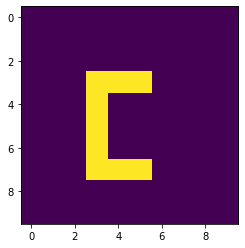

In [146]:
###Visualizing the grid

plt.imshow(MAP)
plt.show()

In [121]:
###Function for dividing each sweep

def sweep_division(grid):
    
    cells = list()
    
    for j in range(grid.shape[1]):
        
        start = False
        start_i = 0
        end_i = 0
        white_to_black = False
        
        for i in range(grid.shape[0]):
            
            if grid[i][j] == 0 and start == False:
                start = True
                start_i = i
        
            if grid[i][j] == 255 and white_to_black == False and start == True:
                end_i = i - 1
                cell = (start_i,end_i,j)
                cells.append(cell)
                white_to_black = True
            
            if grid[i][j] == 0 and white_to_black == True and start == True:
                start_i = i
                white_to_black = False
            
            if i == grid.shape[0] - 1 and white_to_black == False and start == True:
                end_i = i
                cell = (start_i,end_i,j)
                cells.append(cell)
    return cells

In [122]:
###Testing the Above Function

c_test = sweep_division(MAP)
c_test

[(0, 9, 0),
 (0, 9, 1),
 (0, 9, 2),
 (0, 2, 3),
 (8, 9, 3),
 (0, 2, 4),
 (4, 6, 4),
 (8, 9, 4),
 (0, 2, 5),
 (4, 6, 5),
 (8, 9, 5),
 (0, 9, 6),
 (0, 9, 7),
 (0, 9, 8),
 (0, 9, 9)]

In [123]:
###Function for collecting column numbers for a specific start_i and end_i

def collecting_columns(cells):
    
    i_dict = dict()
    
    for cell in cells:
        start_i = cell[0]
        end_i = cell[1]
        bound = (start_i,end_i)
        i_dict[bound] = i_dict.get(bound,0) + 1
    
    i_col = dict()
    
    for i,_ in i_dict.items():
        l = list()
        for c in cells:
            start_i_c = c[0]
            end_i_c = c[1]
            j = c[2]
            b = (start_i_c,end_i_c)
            
            if i == b:
                l.append(j)
            
            i_col[i] = l
    
    return i_col

In [124]:
###Testing the above function

c_col = collecting_columns(c_test)
c_col

{(0, 9): [0, 1, 2, 6, 7, 8, 9],
 (0, 2): [3, 4, 5],
 (8, 9): [3, 4, 5],
 (4, 6): [4, 5]}

In [18]:
###Function for finding the exact column range
from itertools import groupby
from operator import itemgetter

def column_clusters(columns):
    columns.sort()
    
    L = list()
    for k,g in groupby(enumerate(columns), lambda ix:ix[0] - ix[1]):
          L.append(list(map(itemgetter(1), g)))
        
    K = list()
    for l in L:
        K.append([min(l),max(l)])
    
    
    return K
    

In [19]:
###Function for grid division

def grid_division(grid):
    
    cells = sweep_division(grid)
    
    col_dict = collecting_columns(cells)
    
    D = dict()
    
    for f in col_dict.keys():
        sweep = col_dict[f]
        c = column_clusters(sweep)
        D[f] = c
        
    cells = list()
    
    for i,L_j in D.items():
        start_i  = i[0]
        end_i = i[1]
        
        for j in L_j: 
            start_j = j[0]
            end_j = j[1]
            cells.append([start_i,end_i,start_j,end_j])
    
    return cells

In [20]:
###Testing the above function

grids = grid_division(MAP)
grids

[[0, 9, 0, 2], [0, 9, 6, 9], [0, 2, 3, 5], [8, 9, 3, 5], [4, 6, 4, 5]]

In [21]:
###Function for Grid Visualization

def cell_display(grid,cells):
    grid_copy = grid.copy()
    color = 200
    
    for cell in cells:
        start_i = cell[0]
        end_i = cell[1]+1
        start_j = cell[2]
        end_j = cell[3]+1
    
        c_cell = grid_copy[start_i:end_i,start_j:end_j]
        c_cell[c_cell == 0] = color
        color -= 20
    plt.imshow(grid_copy)
    plt.show()

In [22]:
def full_grid():
    plt.imshow(MAP)
    plt.show()

In [23]:
###Function for up to down traversal


def traversal_map_down(A,value):
    alt = True
    m = A.shape[0]
    n = A.shape[1]
    
    i=0
    j=0
    
    while i != m:
        if alt == True:
            A[i][j] = value
            j += 1
            if j == n or A[i][j] == 255:
                i+=1
                alt = False
        else:
            j-=1
            A[i][j] = value
            if j == 0 or A[i][j-1] == 255:
                i+=1
                alt=True
        
        full_grid()
    
    if alt == True:
        return i-1,0
    else:
        return i-1,n-1

In [24]:
###Function for down to up traversal

def traversal_map_up(grid,value):
    alt = True
    m = grid.shape[0]
    n = grid.shape[1]
    
    i = m-1
    j = 0
    while i != -1:
        if alt == True:
            grid[i][j] = value
            j += 1
            if j == n or grid[i][j] == 255:
                i-=1
                alt = value
        else:
            j-=1
            grid[i][j] = 127
            if j == 0 or grid[i][j-1] == 255:
                i-=1
                alt=True
        
        full_grid()
    
    if alt == True:
        return 0,0
    else:
        return 0,n-1

In [25]:
###Distance Formula
import math

def distance_formula(x1,y1,x2,y2):
    dist = math.sqrt((x1-x2)**2+(y1-y2)**2)
    return dist

In [26]:
###Function for Reordering the cells list


def next_cell(sr_x,sr_y,cell_dict,cell_i):
    nearest = None
    nearest_index = None
    movement = None
    
    for ind,c in cell_dict.items():
        down = False
        
        if ind == cell_i:
            continue
        
        de_x_d = c[0]
        de_y_d = c[2]
        d_d = distance_formula(sr_x,sr_y,de_x_d,de_y_d)
        
        de_x_u = c[1]
        de_y_u = c[2]
        d_u = distance_formula(sr_x,sr_y,de_x_u,de_y_u)
        
        if d_d<d_u:
            d = d_d
            down = True
        else:
            d = d_u
            down = False
        
        if nearest == None or nearest > d:
            print(down)
            nearest = d
            nearest_index = ind
            
            if down == True:
                movement = 'Down'
            else:
                movement = 'Up'
            print(movement)
    del cell_dict[cell_i]
        
    cell_i = nearest_index
    
    return movement,cell_i,cell_dict[cell_i]

In [27]:
###Djikstra Implementaion

from queue import PriorityQueue
import math

def index(r,c,k):
    return r*k + c #Encoding

def dijkstra(sr_x,sr_y,de_x,de_y,grid,val):
    dist = np.ones(grid.shape)
    prev = np.ones(grid.shape)
    dist = 50000*dist
    prev = 40000*prev
    k = 1000
    visited = np.zeros(grid.shape)
    p_q = PriorityQueue()
    
    for i in range(grid.shape[0]):
        for j in range(grid.shape[1]):
            if grid[i][j] == 255:
                visited[i][j] = 1
    
    node = [0.0,index(sr_x,sr_y,k)]
    p_q.put(node)
    
    while not p_q.empty():
        current = p_q.get()
        ind = current[1]
        r = ind // k
        c = ind - r*k
        
        dr = [1,-1,0,0,1,1,-1,-1]
        dc=  [0,0,1,-1,1,-1,1,-1]
        
        L = list()
        for i in range(len(dr)):
            rr = r+dr[i]
            cc = c+dc[i]
            if cc < 0 or rr < 0 or rr > grid.shape[0]-1 or cc > grid.shape[1]-1 or grid[rr][cc] == 255 or visited[rr][cc] == 1:
                continue
            else:
                if i<=3:
                    alt = current[0] +1
                else:
                    alt = current[0] + 1.414
            
            if alt < dist[rr][cc]:
                visited[rr][cc] = 1
                L.append((rr,cc))
                dist[rr][cc] = alt
                prev[rr][cc] = index(r,c,k)
                p_q.put([alt,index(rr,cc,k)])
                
            if visited[de_x][de_y] == 1:
                break
        if visited[de_x][de_y] == 1:
            break
    
    grid[de_x][de_y] = val
    r = de_x
    c= de_y
    while(True):
        n = prev[r][c]
        r = int(n // k)
        c = int(n - r*k)
        grid[r][c] = val
        plt.imshow(grid)
        plt.show()
        if grid[sr_x][sr_y] == val:
            break

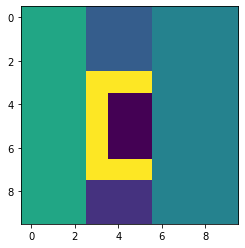

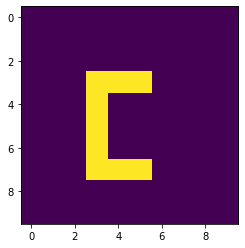

{}


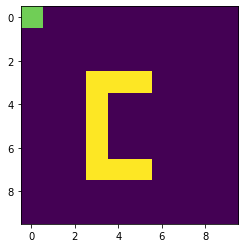

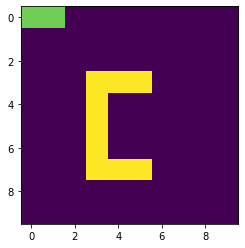

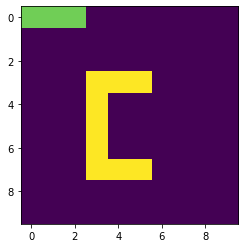

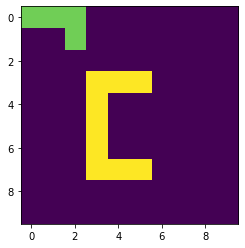

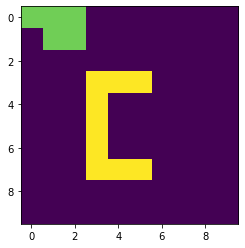

...

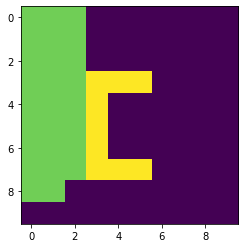

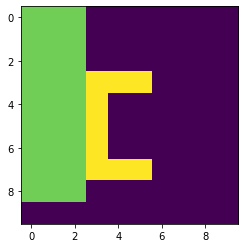

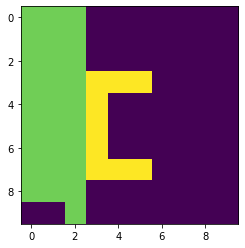

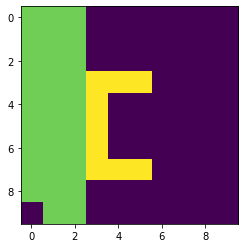

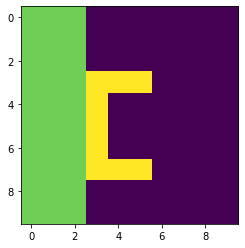

False
Up
False
Up
180 True
9 3 9 0


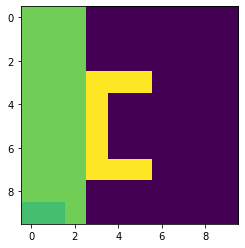

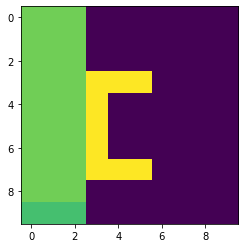

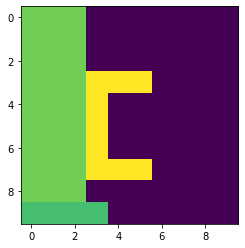

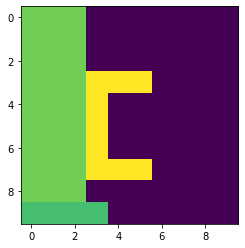

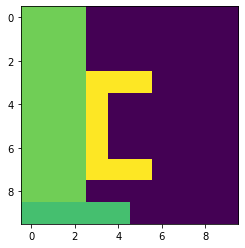

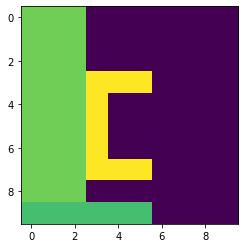

KeyboardInterrupt: 

In [28]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    if movement == 'Down':
        sr_x,sr_y = traversal_map_down(c_cell,value)
    else:
        sr_x,sr_y = traversal_map_up(c_cell,value)
    
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        de_x = n_cell[0]
        de_y = n_cell[2]
    else:
        de_x = n_cell[1]
        de_y = n_cell[2]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [33]:
#####################
## 4 Entry Points
#####################

In [34]:
###Function for up to down traversal

def traversal_map_down(A,value,side):
    m = A.shape[0]
    n = A.shape[1]
    
    if side == 'Left':
        i=0
        j=0
        alt = True
        
        while i != m:
            if alt == True:
                A[i][j] = value
                j+=1
                if j == n :
                    i+=1
                    alt = False
            
            else:
                j-=1
                A[i][j] = value
                if j == 0 :
                    i+=1
                    alt = True
            full_grid()
            
        if alt ==True:
            return i-1,0
        else:
            return i-1,n-1
    else:
        i=0    
        j=n-1
        alt = False
        
        while i!=m:
            if alt == False:
                A[i][j] = value
                j-=1
                
                if j==-1:
                    i+=1
                    alt = True
            else:
                j+=1
                A[i][j] = value
                if j == n-1:
                    i+=1
                    alt = False
            full_grid()
            
            
        
        if alt == True:
            return i-1,0
        else:
            return i-1,n-1     

In [35]:
###Function for down to up traversal

def traversal_map_up(A,value,side):
    m = A.shape[0]
    n = A.shape[1]
    
    if side == 'Left':
        i=m-1
        j =0
        alt = True
        
        while i != -1:
            if alt == True:
                A[i][j] = value
                j+=1
                if j == n :
                    i-=1
                    alt = False
            
            else:
                j-=1
                A[i][j] = value
                if j == 0 :
                    i-=1
                    alt = True
            full_grid()
            
        if alt ==True:
            return 0,0
        else:
            return 0,n-1
    else:
        i=m-1    
        j=n-1
        alt = False
        
        while i!=-1:
            if alt == False:
                A[i][j] = value
                j-=1
                
                if j==-1:
                    i-=1
                    alt = True
            else:
                j+=1
                A[i][j] = value
                if j == n-1:
                    i-=1
                    alt = False
            full_grid()
        
        if alt == True:
            return 0,0
        else:
            return 0,n-1    

In [36]:
###Function for Reordering the cells list


def next_cell(sr_x,sr_y,cell_dict,cell_i):
    nearest = None
    nearest_index = None
    movement = None
    side = None
    
    for ind,c in cell_dict.items():
        mov = None
        s = None
        
        if ind == cell_i:
            continue
        
        de_x_d_l = c[0]
        de_y_d_l = c[2]
        d_d_l = distance_formula(sr_x,sr_y,de_x_d_l,de_y_d_l)
        
        de_x_u_l = c[1]
        de_y_u_l = c[2]
        d_u_l = distance_formula(sr_x,sr_y,de_x_u_l,de_y_u_l)
        
        de_x_d_r = c[0]
        de_y_d_r = c[3]
        d_d_r = distance_formula(sr_x,sr_y,de_x_d_r,de_y_d_r)
        
        de_x_u_r = c[1]
        de_y_u_r = c[3]
        d_u_r = distance_formula(sr_x,sr_y,de_x_u_r,de_y_u_r)
        
        dists = np.array([d_d_l,d_u_l,d_d_r,d_d_r])
        K = np.argmin(dists)
        d = dists[K]
        
        if K==0:
            mov = 'Down'
            s = 'Left'
        if K==1:
            mov = 'Up'
            s = 'Left'
        if K==2:
            mov = 'Down'
            s = 'Right'
        if K==3:
            mov = 'Up'
            s = 'Right'
            
        
        if nearest == None or nearest > d:
            
            nearest = d
            nearest_index = ind
            movement = mov
            side = s
    del cell_dict[cell_i]
        
    cell_i = nearest_index
    
    return side,movement,cell_i,cell_dict[cell_i]

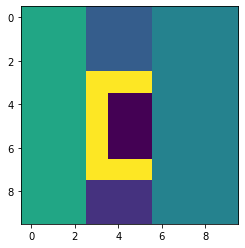

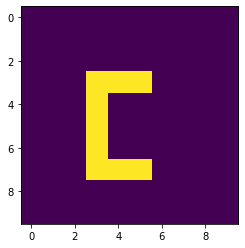

{}


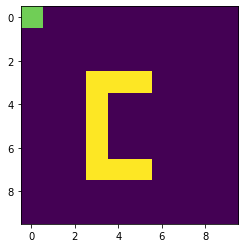

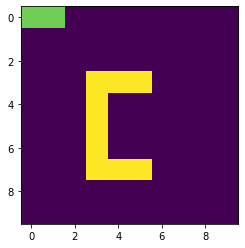

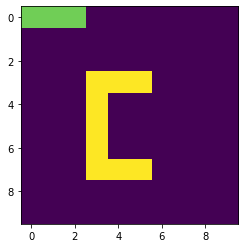

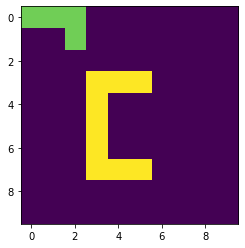

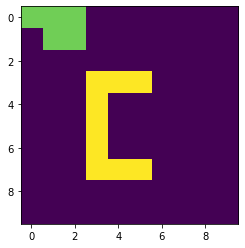

...

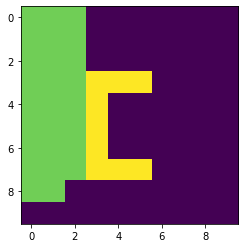

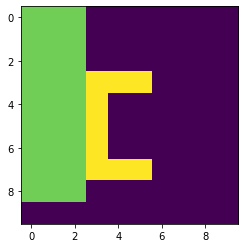

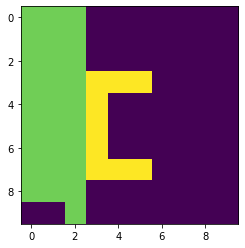

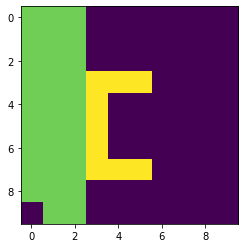

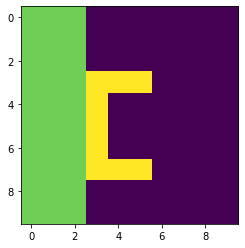

180 True
9 3 9 0


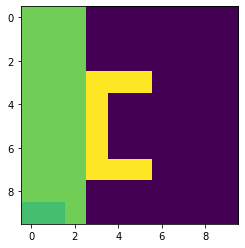

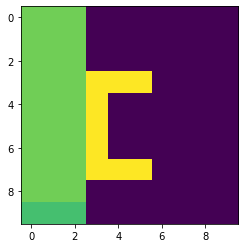

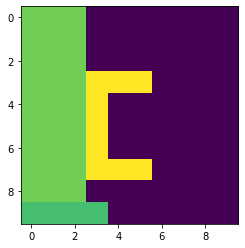

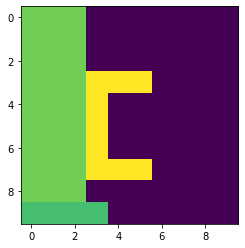

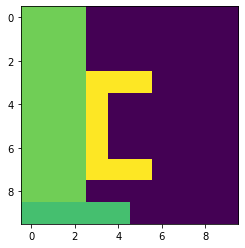

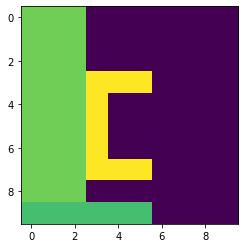

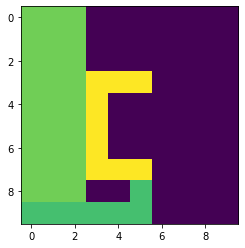

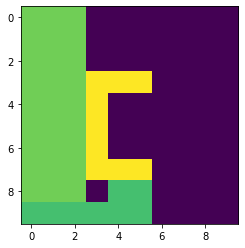

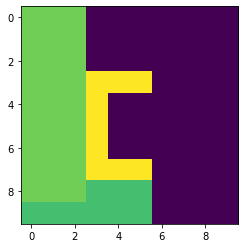

160 True
6 4 8 3


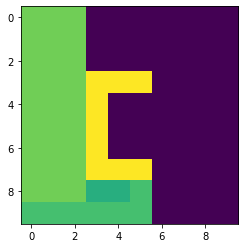

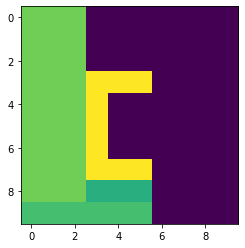

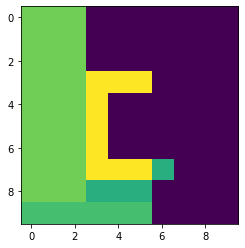

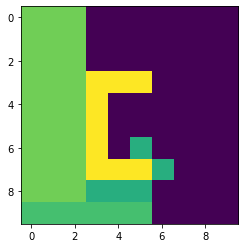

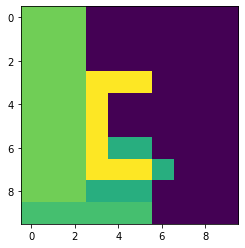

...

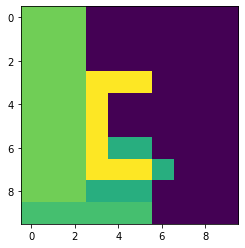

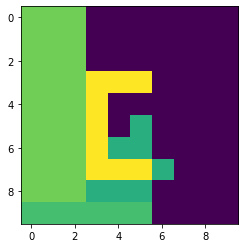

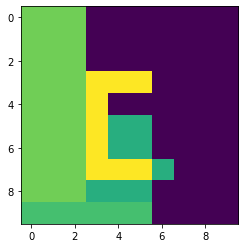

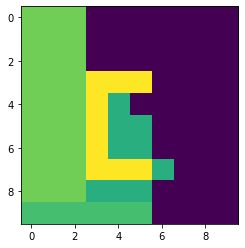

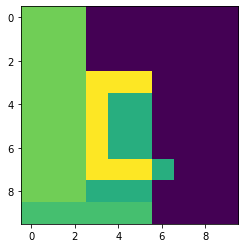

140 True
2 3 4 5


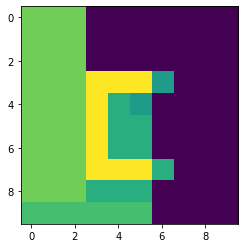

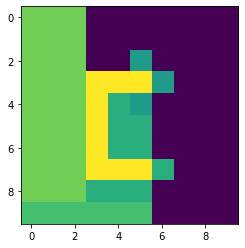

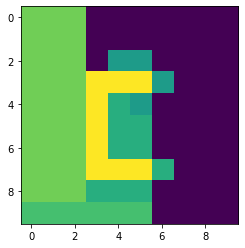

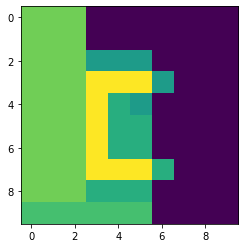

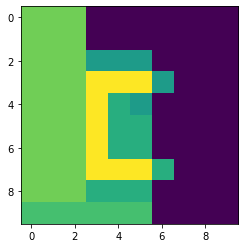

...

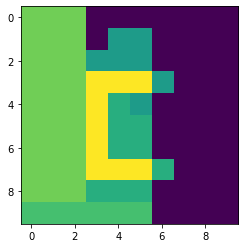

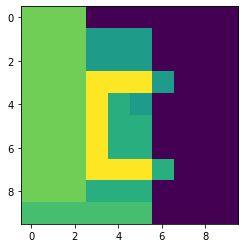

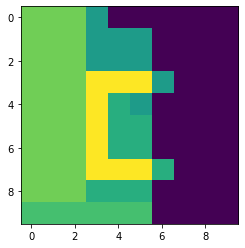

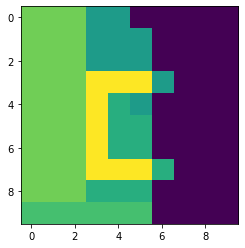

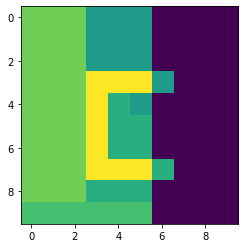

120 True
0 6 0 5


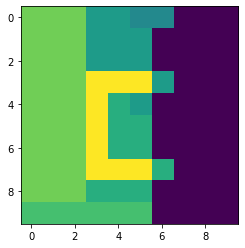

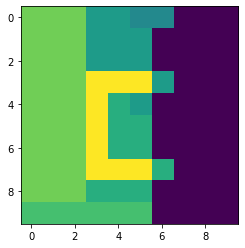

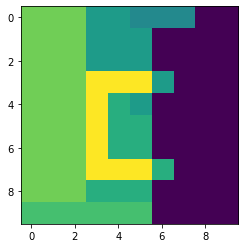

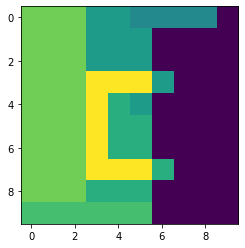

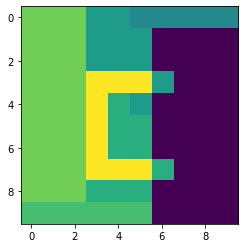

...

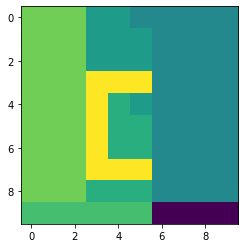

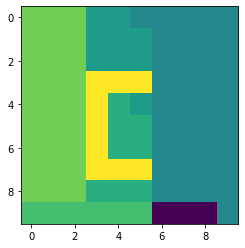

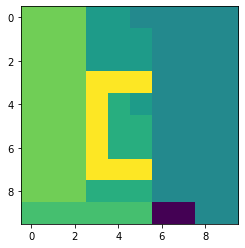

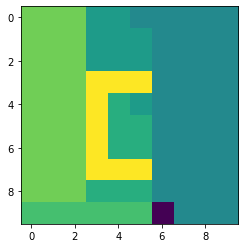

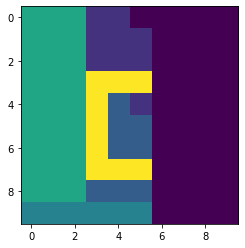

In [31]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    if movement == 'Down':
        sr_x,sr_y = traversal_map_down(c_cell,value,side)
    else:
        sr_x,sr_y = traversal_map_up(c_cell,value,side)
    
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [32]:
###Reading an Image
import cv2 as cv

MAP_test = cv.imread('Map_test_1.png')
MAP_test_gs = cv.cvtColor(MAP_test, cv.COLOR_BGR2GRAY)
_,MAP_test_work = cv.threshold(MAP_test_gs,127,255,cv.THRESH_BINARY_INV)
MAP = MAP_test_work
print(MAP.shape)

(17, 29)


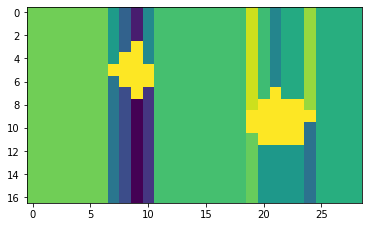

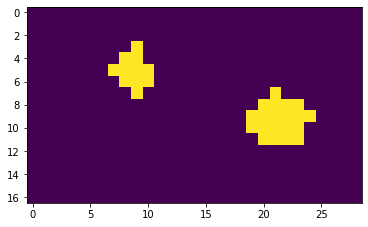

{}


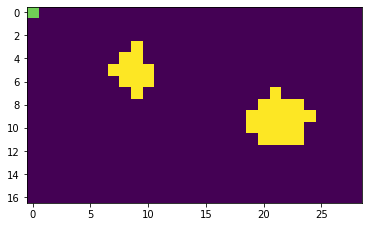

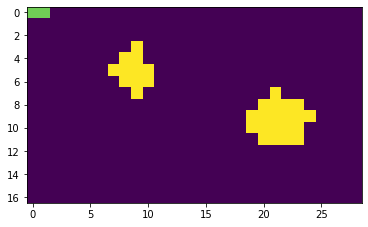

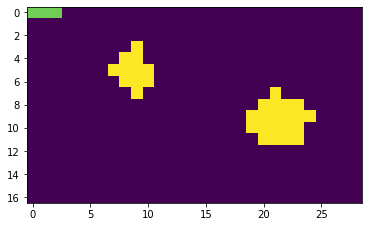

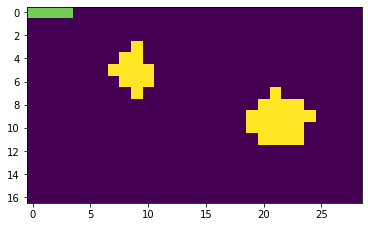

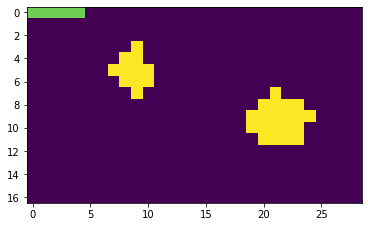

...

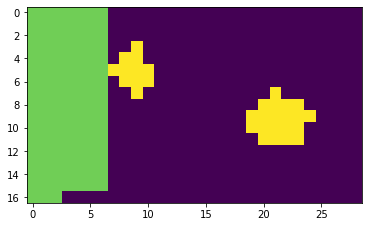

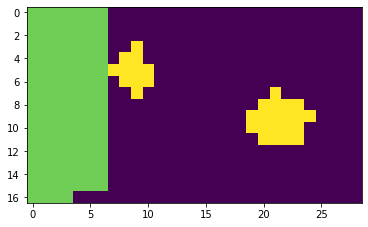

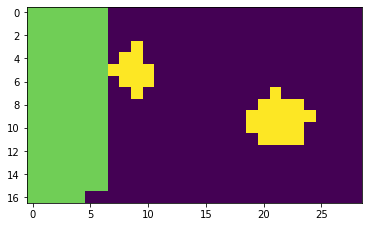

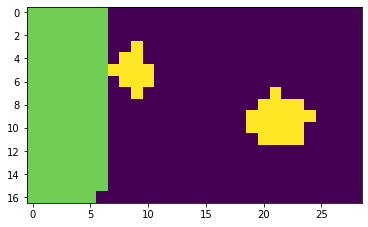

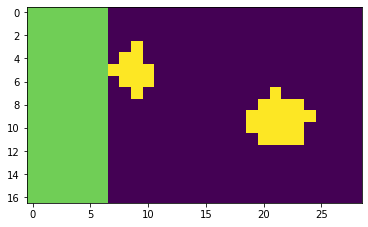

180 True
16 7 16 6


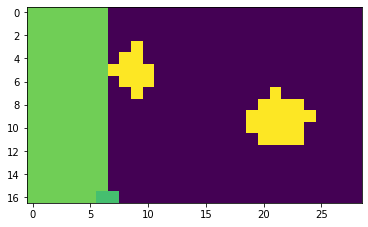

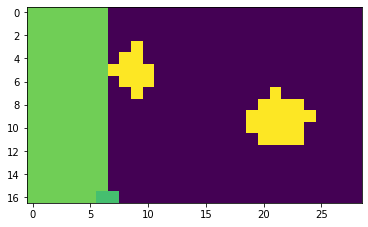

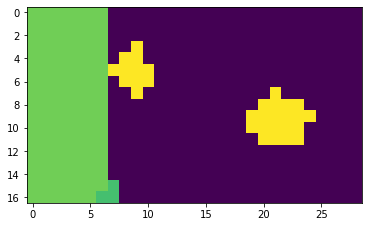

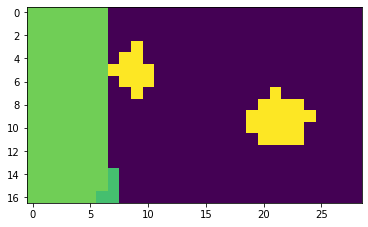

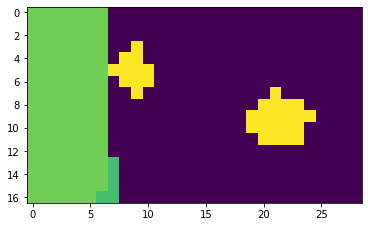

...

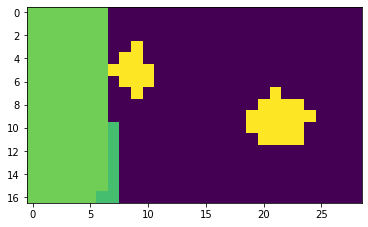

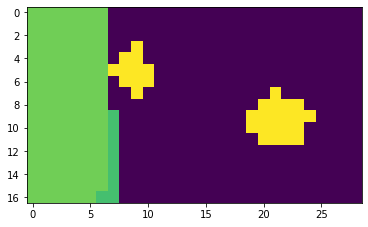

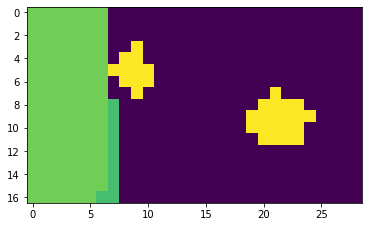

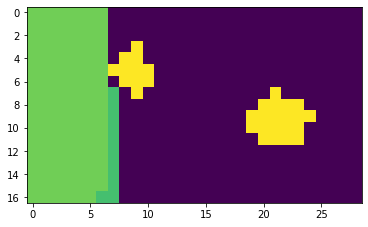

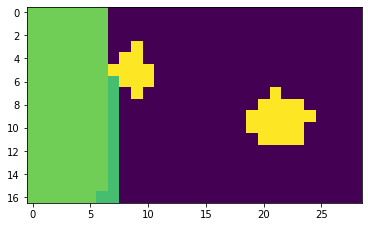

160 True
7 8 6 7


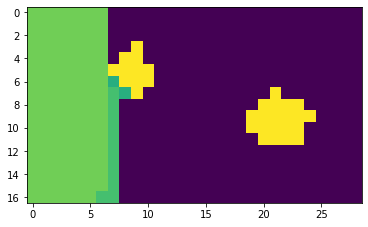

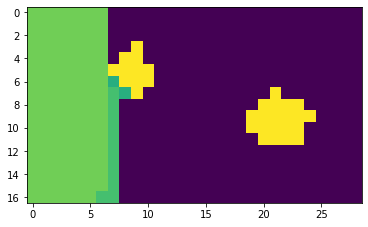

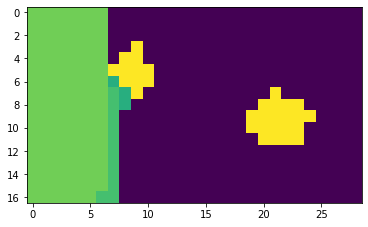

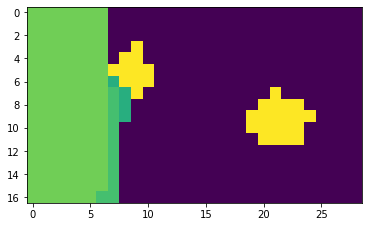

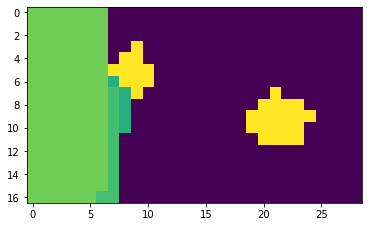

...

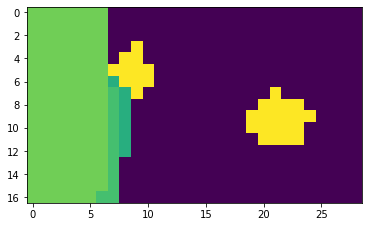

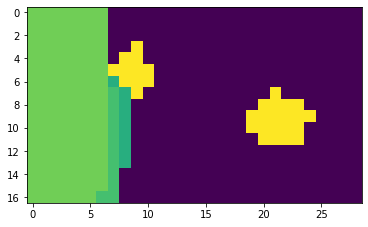

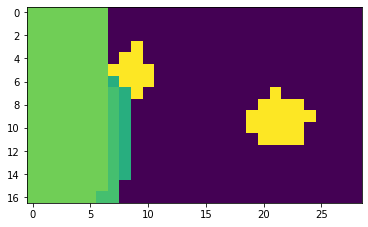

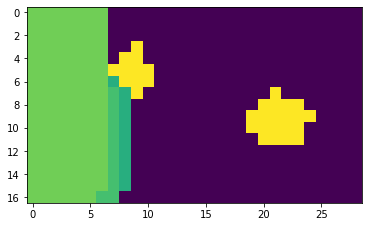

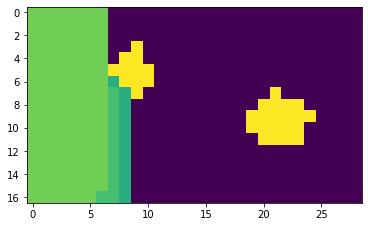

140 True
16 9 16 8


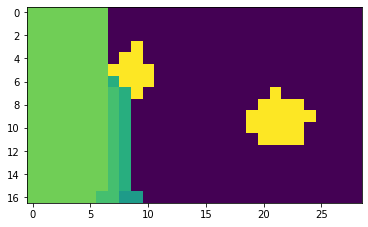

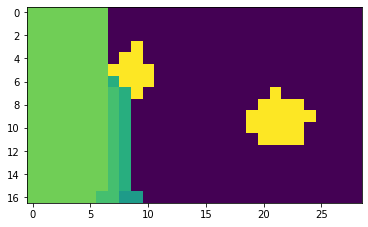

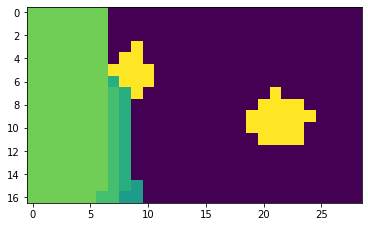

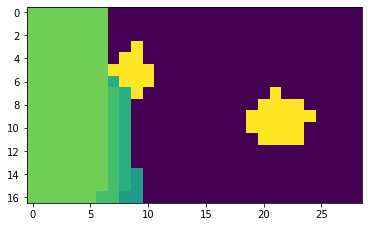

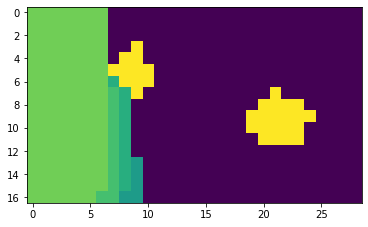

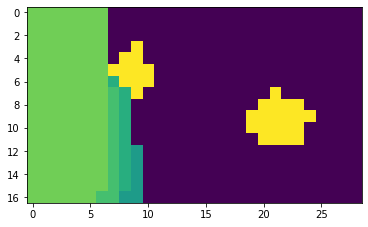

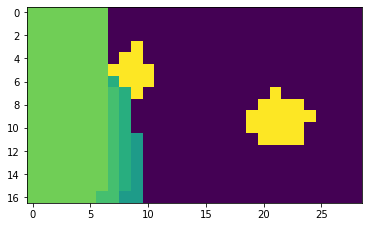

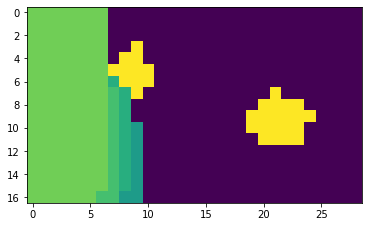

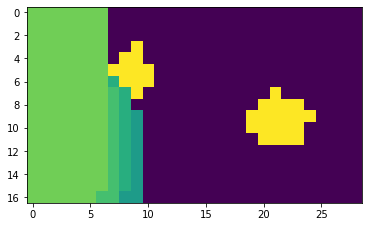

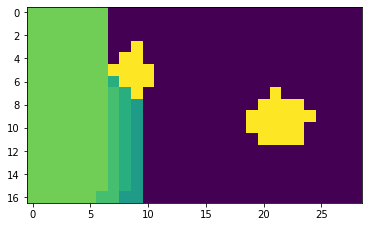

120 True
7 10 8 9


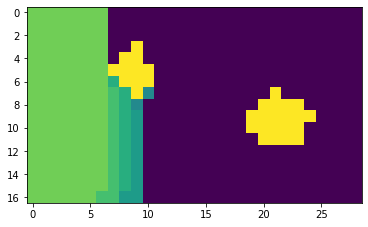

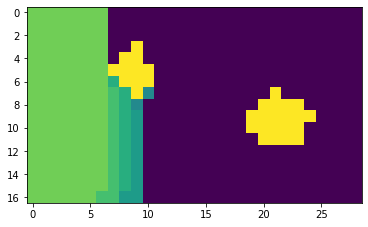

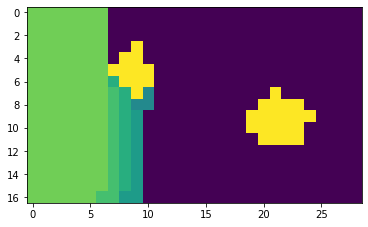

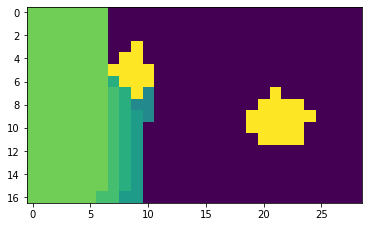

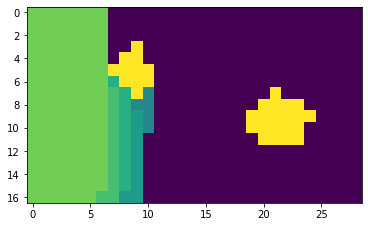

...

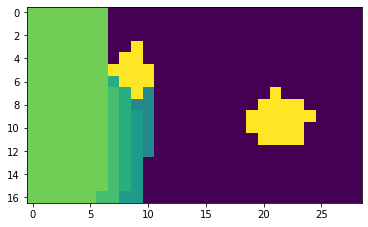

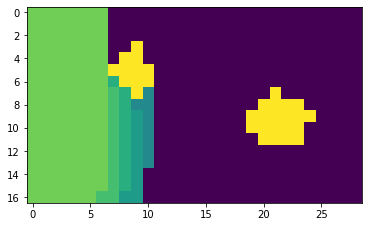

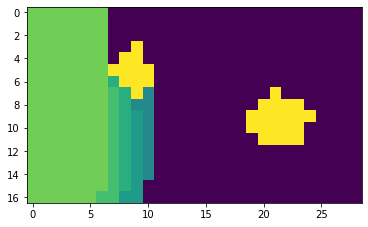

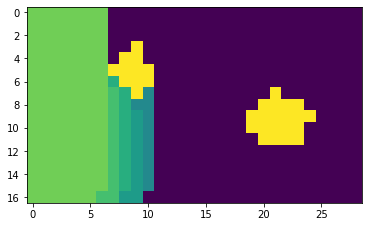

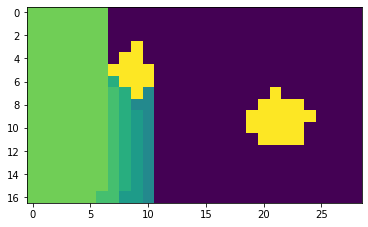

100 True
16 11 16 10


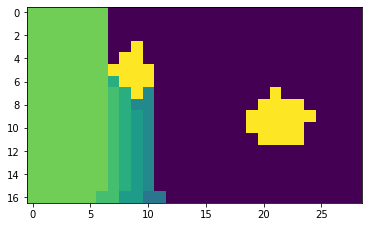

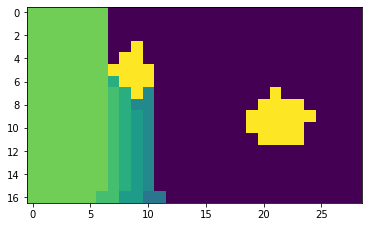

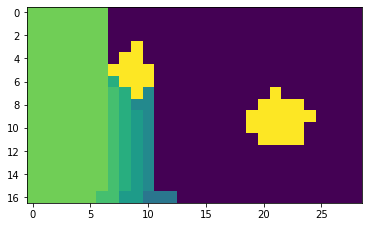

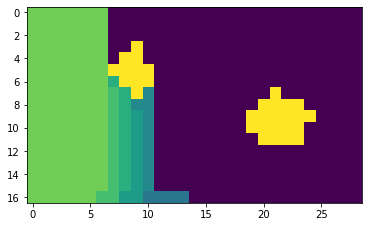

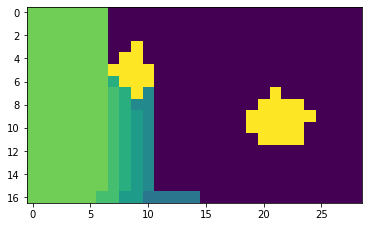

...

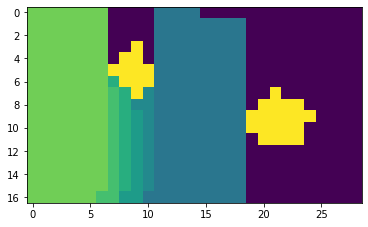

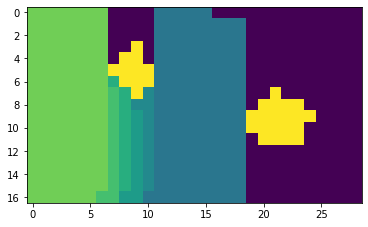

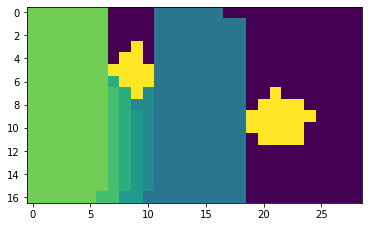

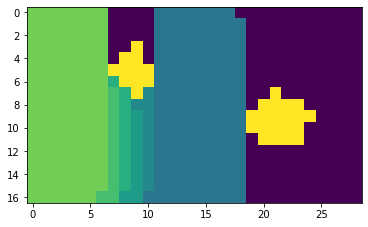

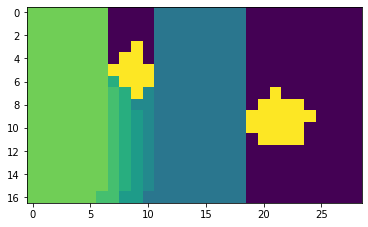

120 False
0 19 0 18


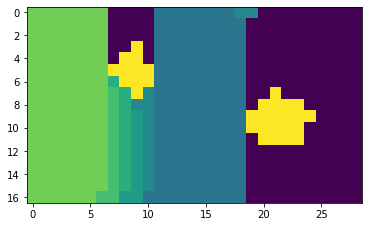

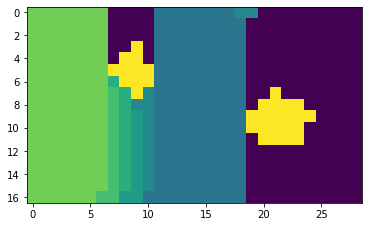

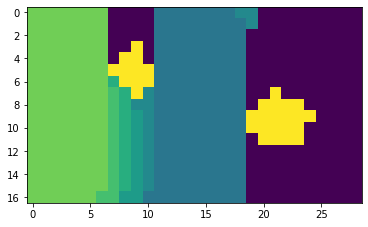

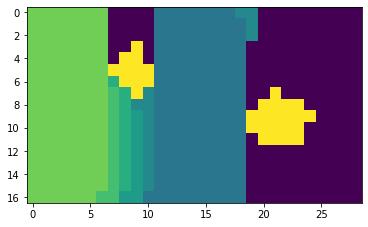

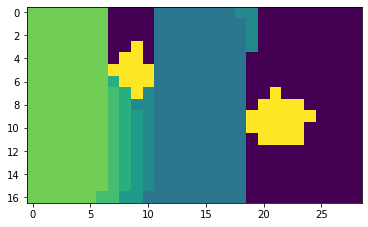

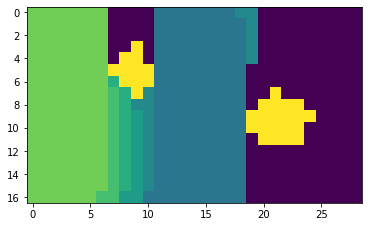

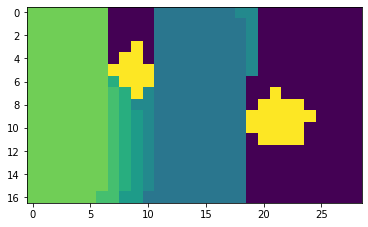

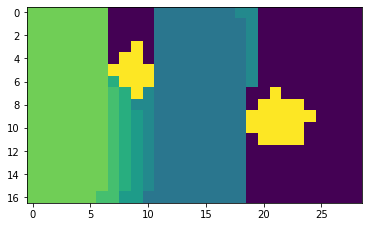

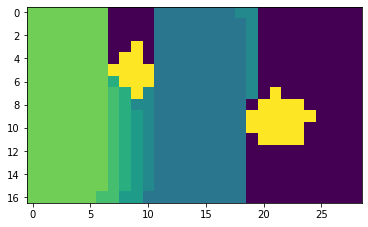

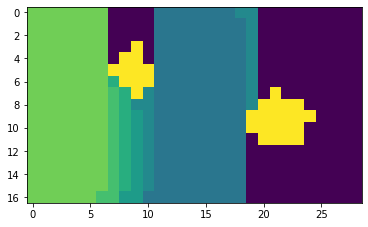

140 False
7 20 8 19


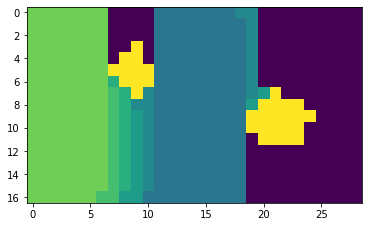

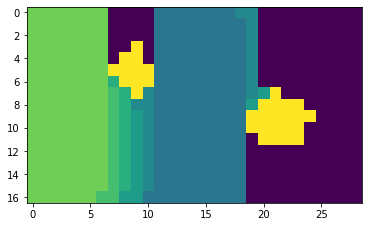

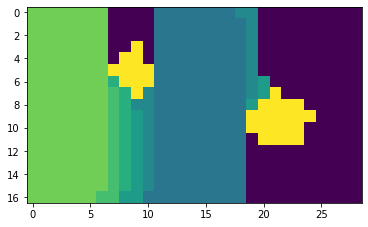

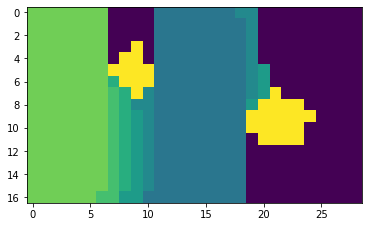

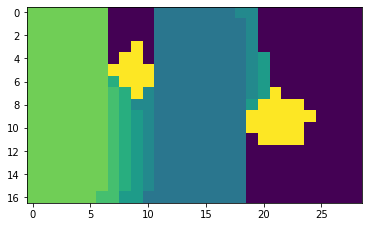

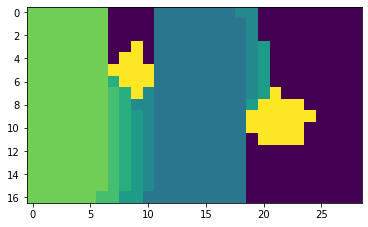

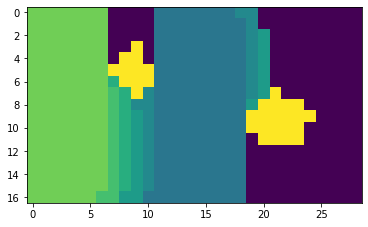

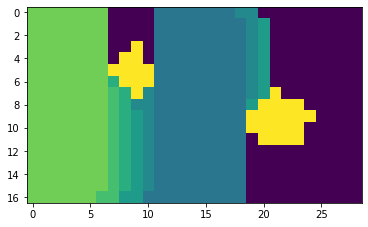

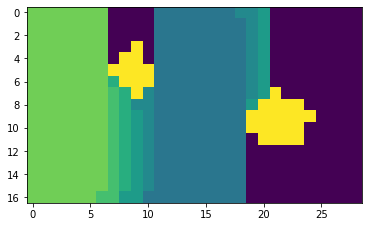

160 False
0 21 0 20


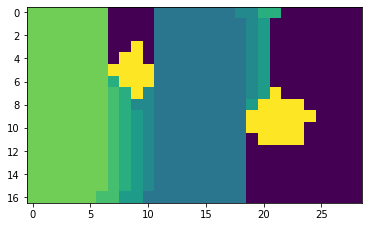

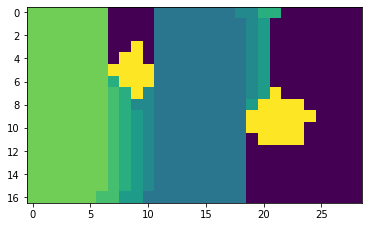

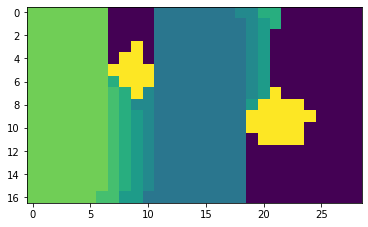

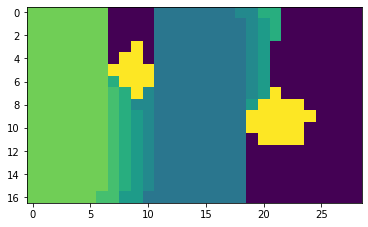

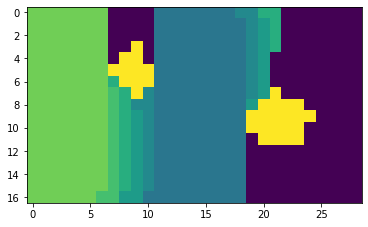

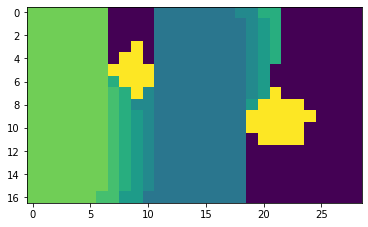

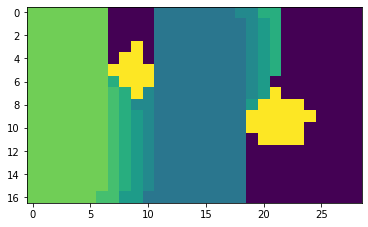

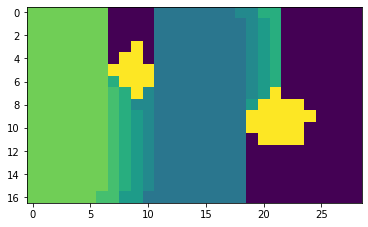

180 False
7 22 6 21


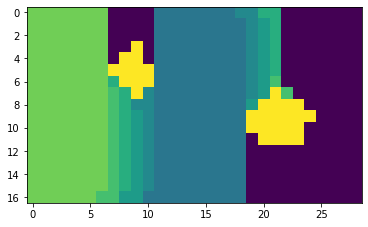

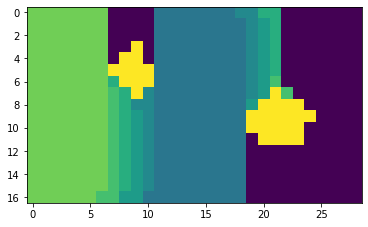

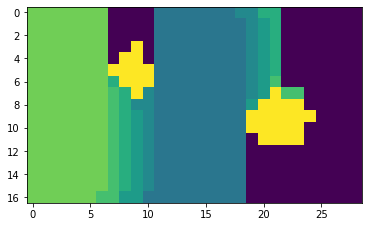

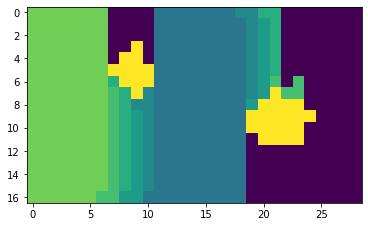

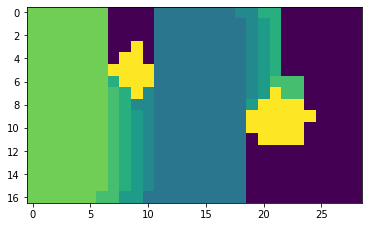

...

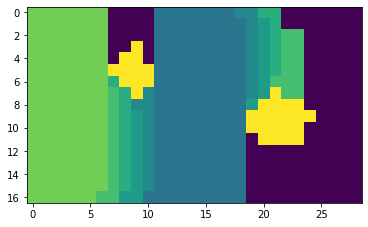

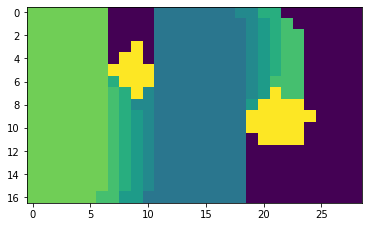

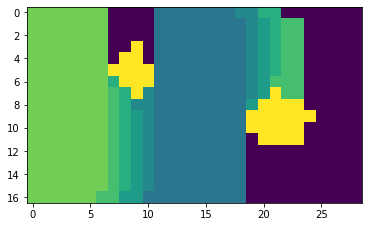

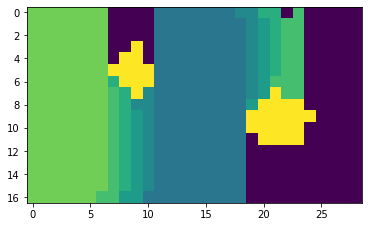

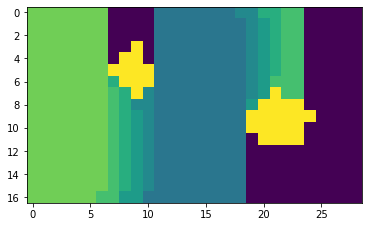

200 False
0 24 0 22


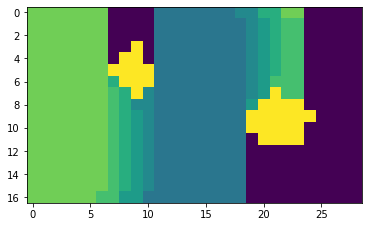

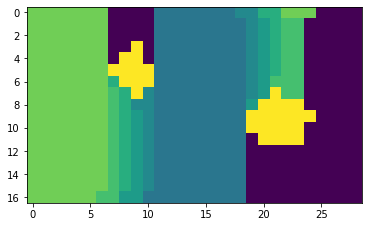

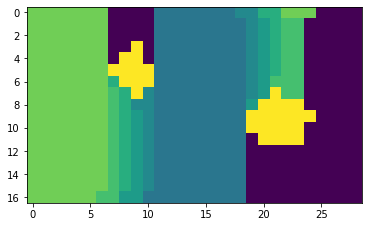

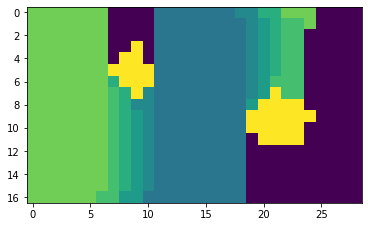

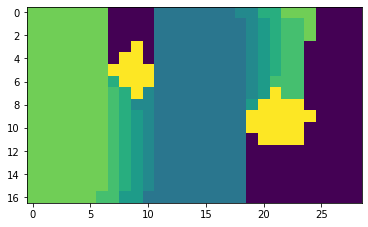

...

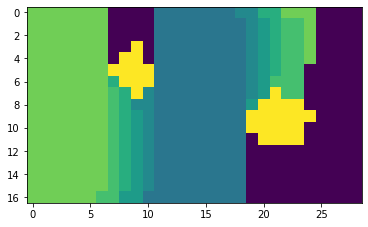

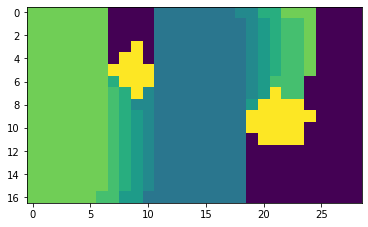

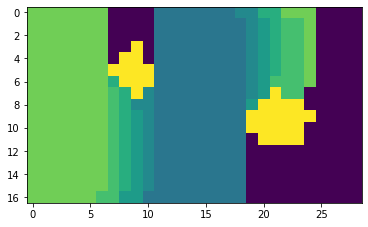

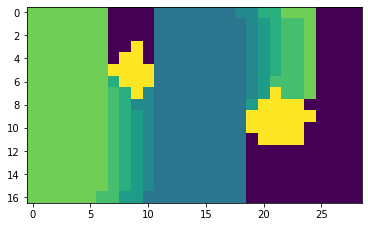

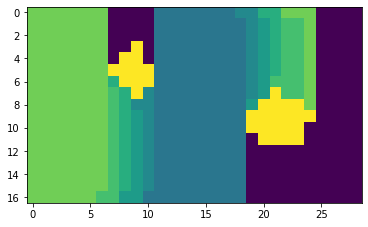

200 True
10 24 8 24


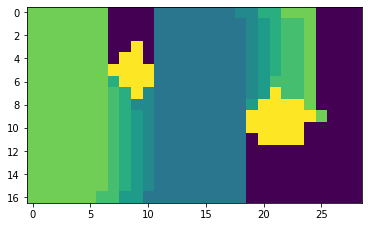

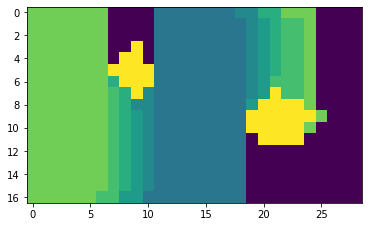

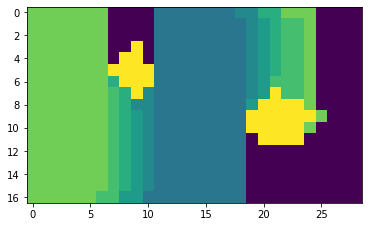

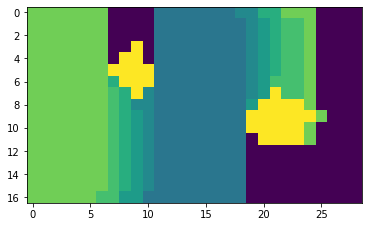

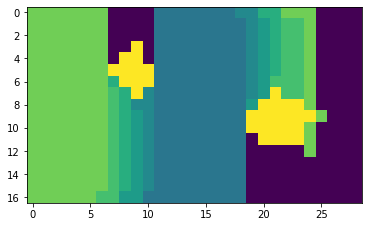

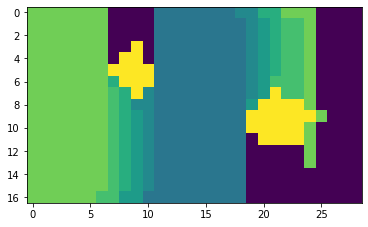

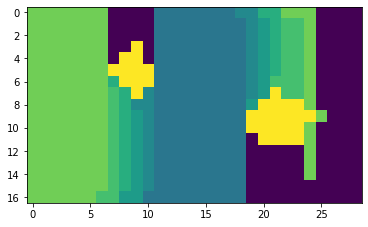

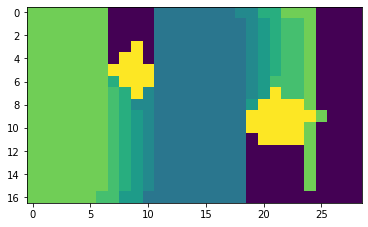

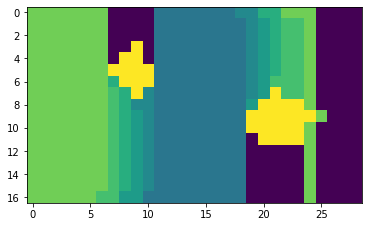

180 True
16 25 16 24


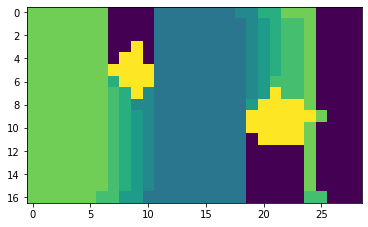

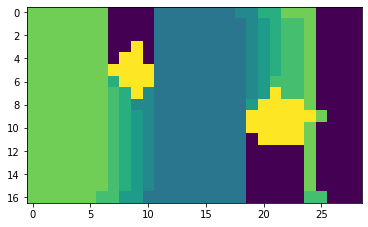

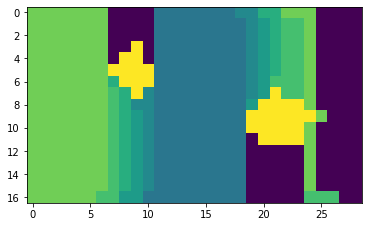

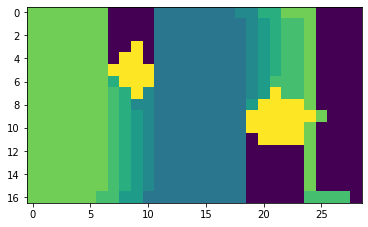

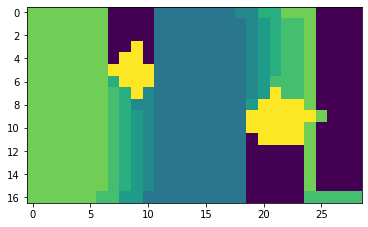

...

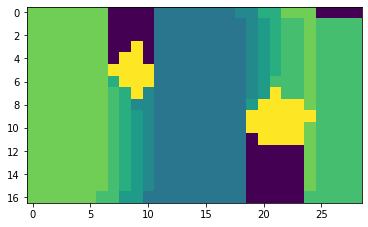

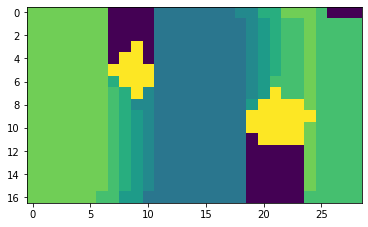

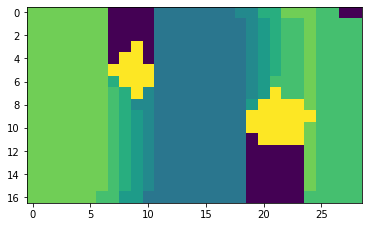

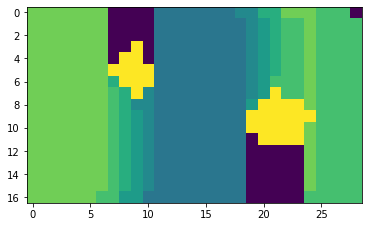

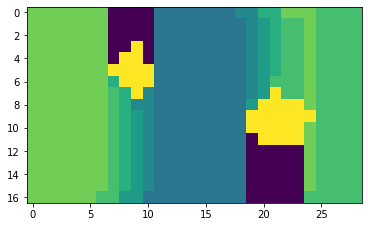

160 True
12 23 0 28


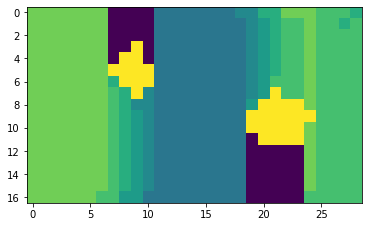

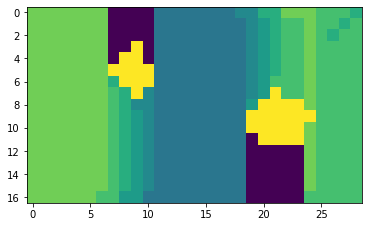

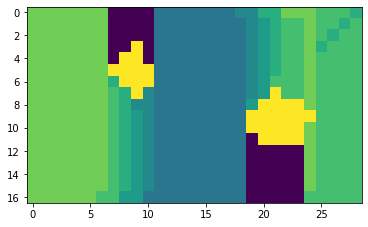

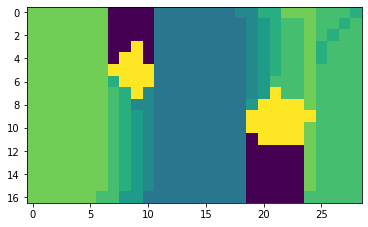

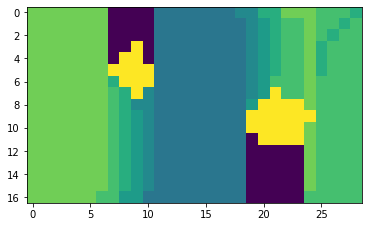

...

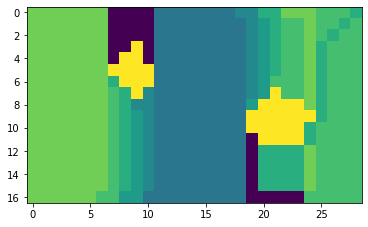

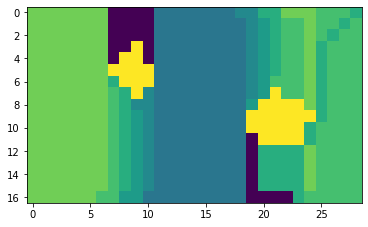

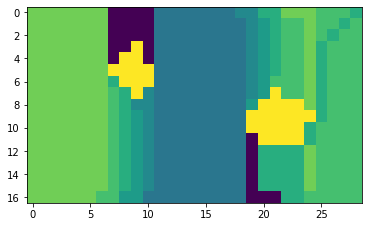

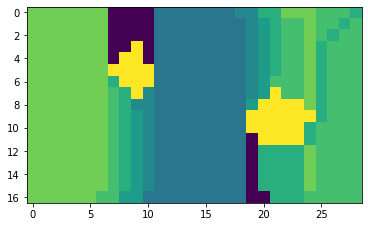

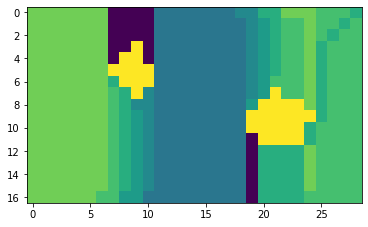

140 True
16 19 16 20


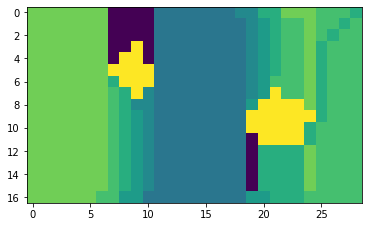

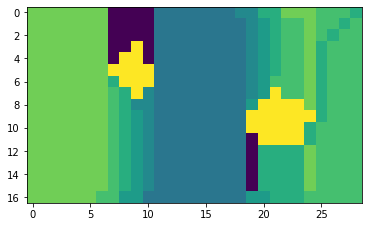

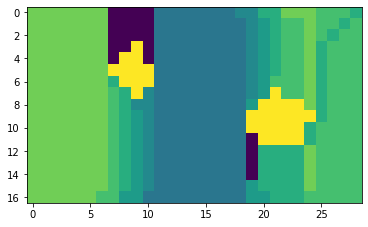

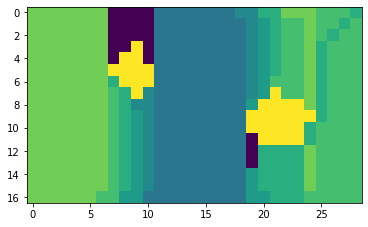

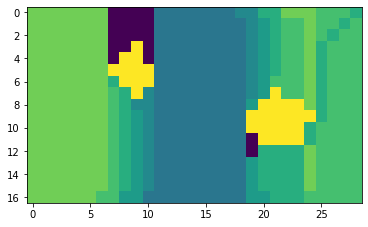

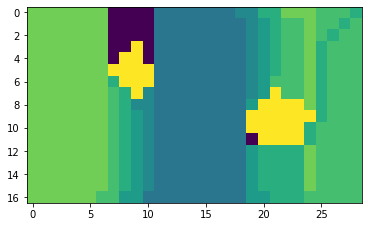

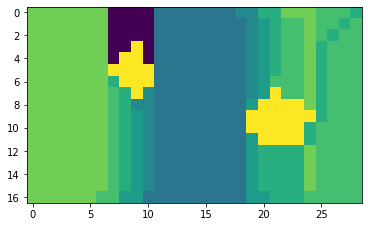

120 True
4 10 11 19


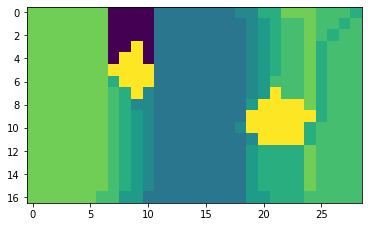

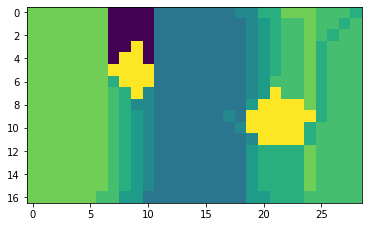

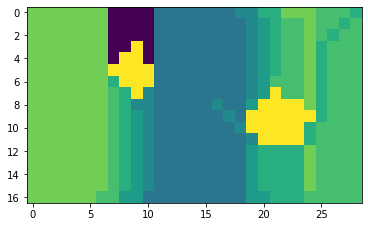

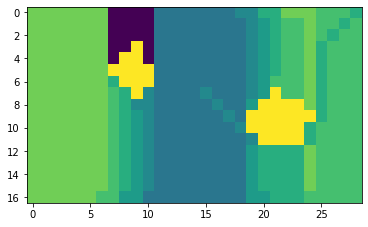

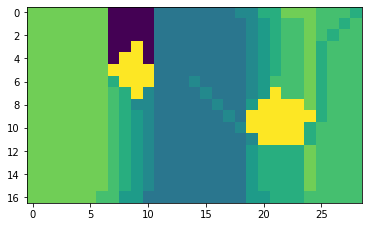

...

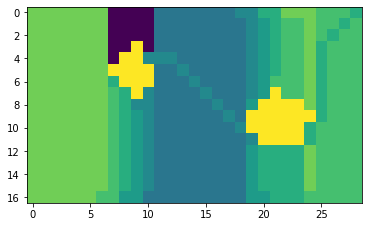

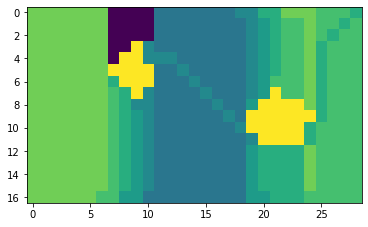

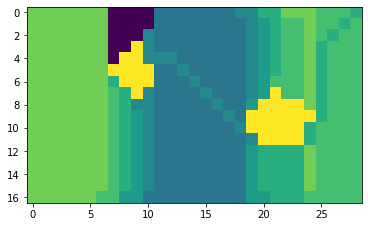

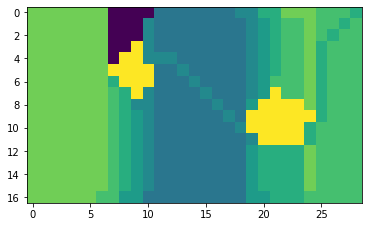

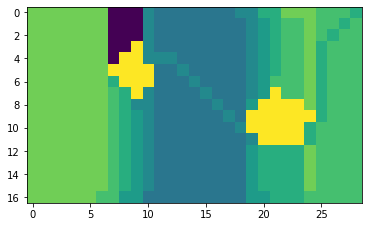

100 True
0 9 0 10


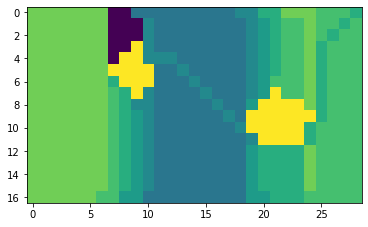

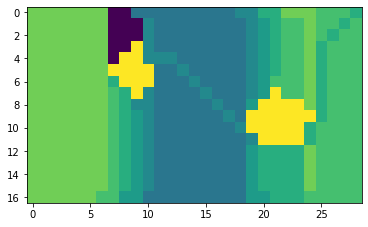

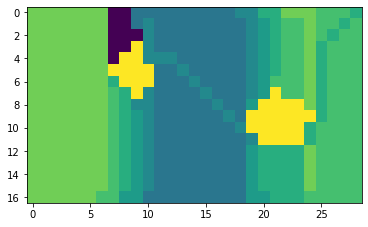

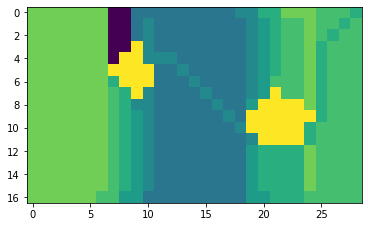

120 False
3 8 2 9


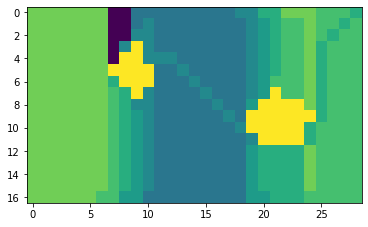

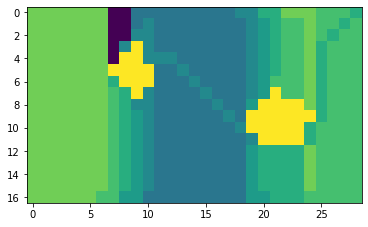

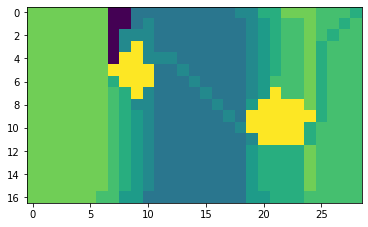

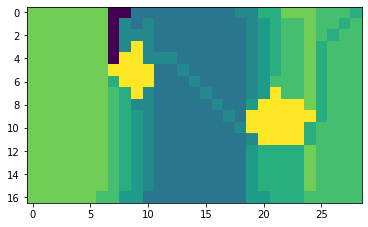

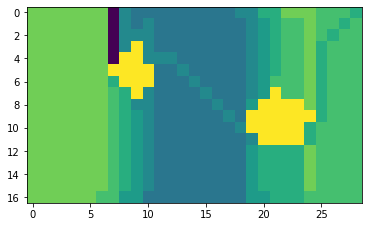

140 False
0 7 0 8


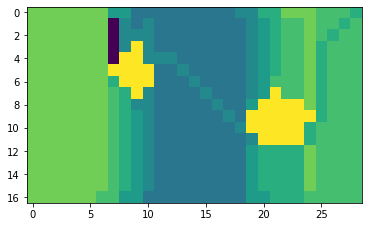

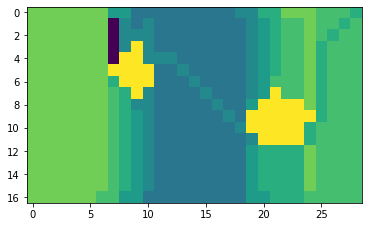

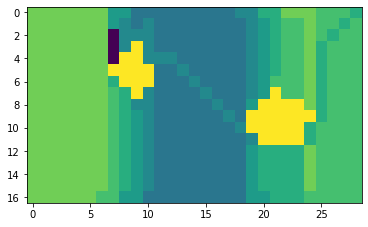

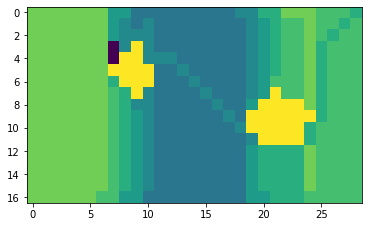

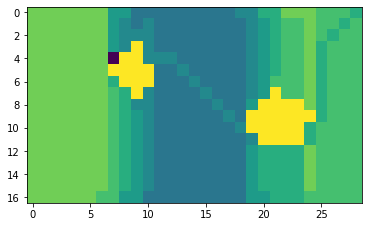

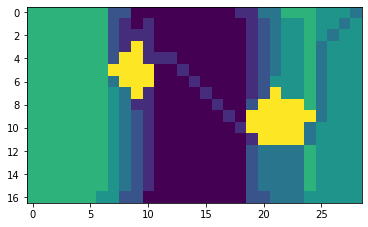

In [33]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    if movement == 'Down':
        sr_x,sr_y = traversal_map_down(c_cell,value,side)
    else:
        sr_x,sr_y = traversal_map_up(c_cell,value,side)
    
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [35]:
###Reading an Image
import cv2 as cv

MAP_test = cv.imread('Map_test_2.png')
MAP_test_gs = cv.cvtColor(MAP_test, cv.COLOR_BGR2GRAY)
_,MAP_test_work = cv.threshold(MAP_test_gs,127,255,cv.THRESH_BINARY_INV)
MAP = MAP_test_work
print(MAP.shape)

(31, 69)


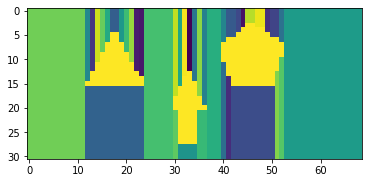

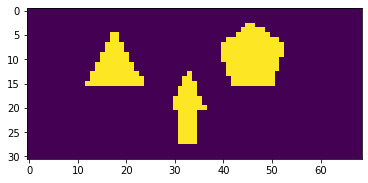

{}


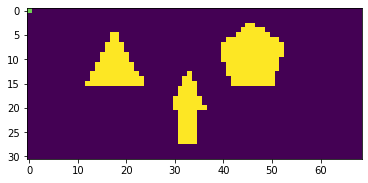

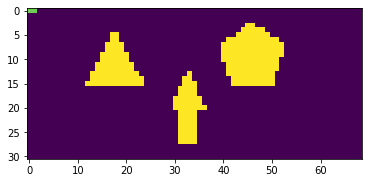

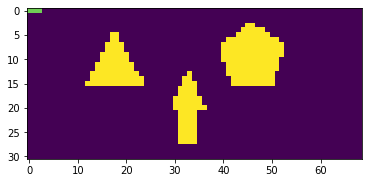

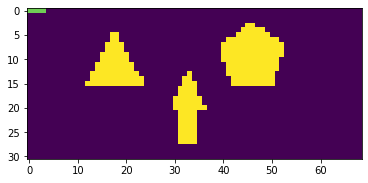

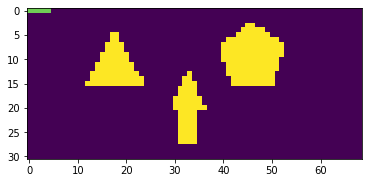

...

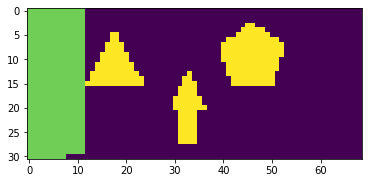

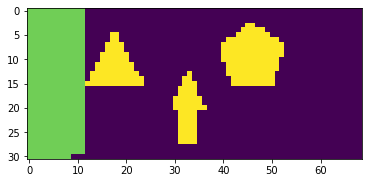

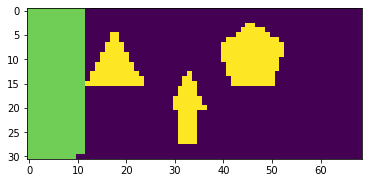

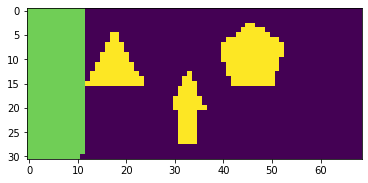

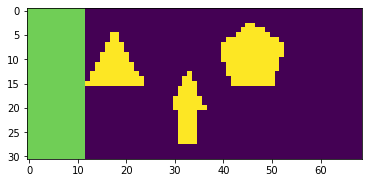

180 True
30 12 30 11


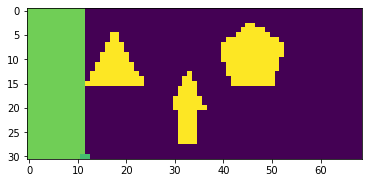

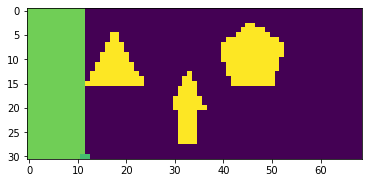

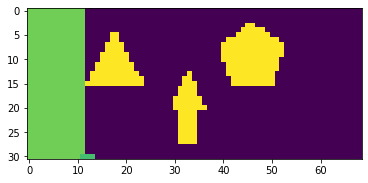

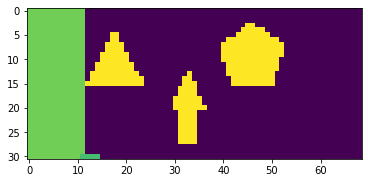

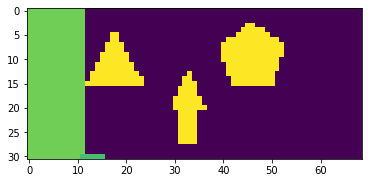

...

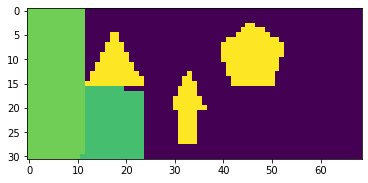

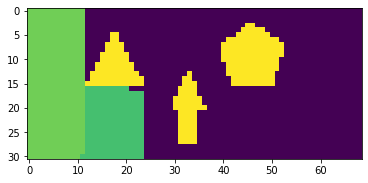

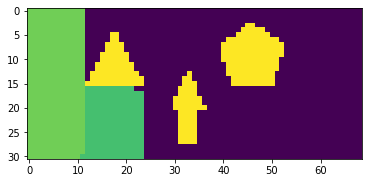

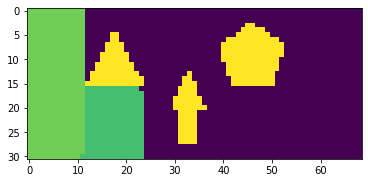

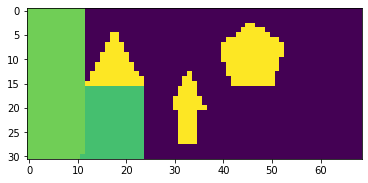

160 True
13 23 16 23


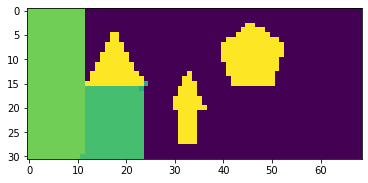

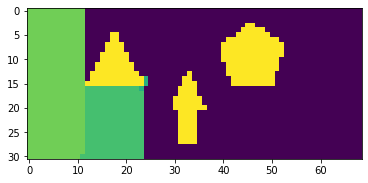

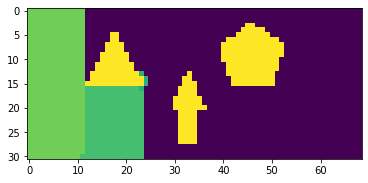

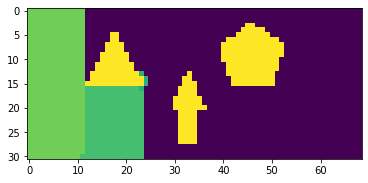

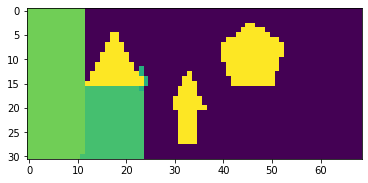

...

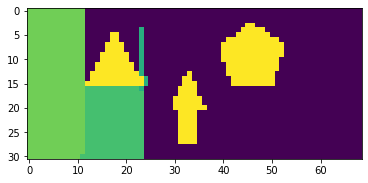

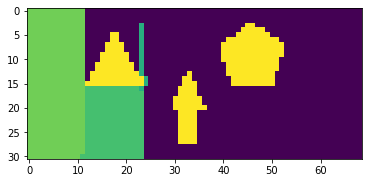

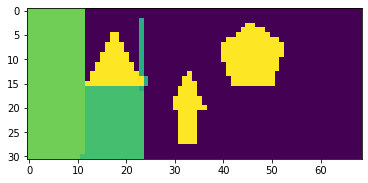

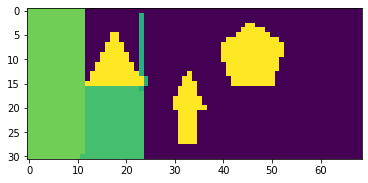

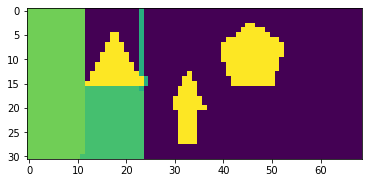

140 True
0 24 0 23


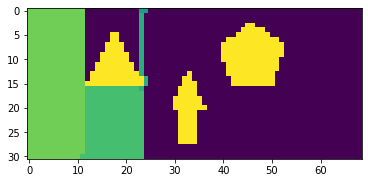

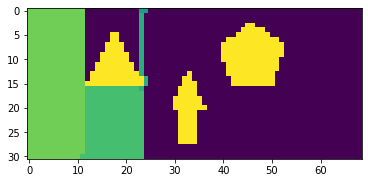

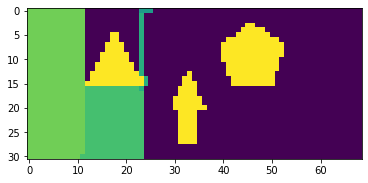

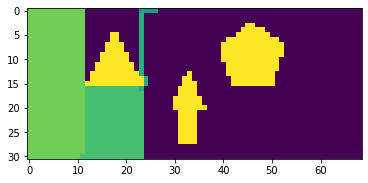

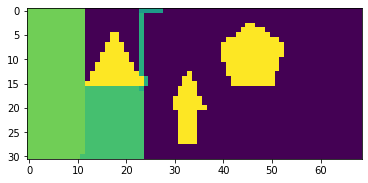

...

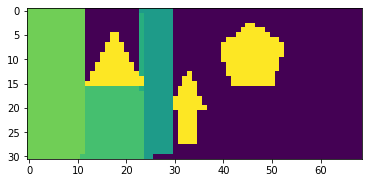

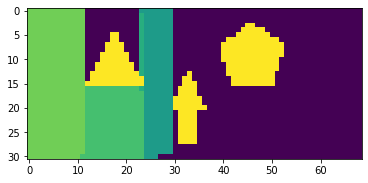

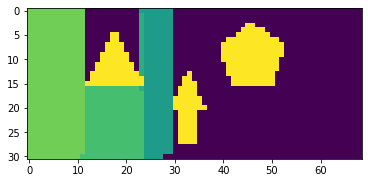

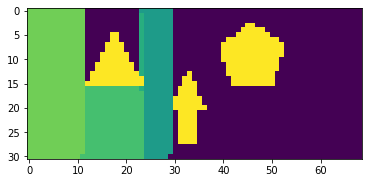

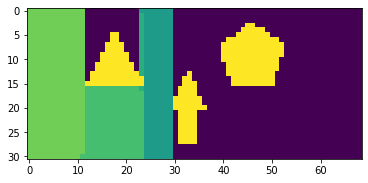

120 True
30 30 30 29


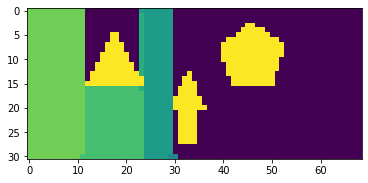

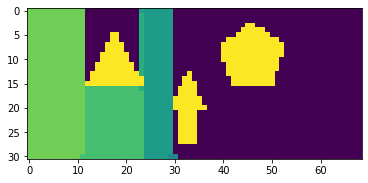

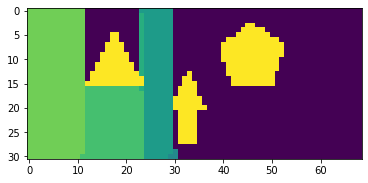

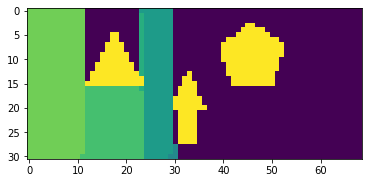

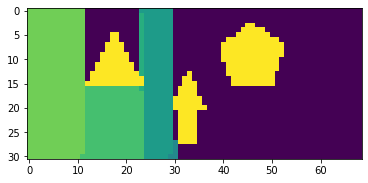

...

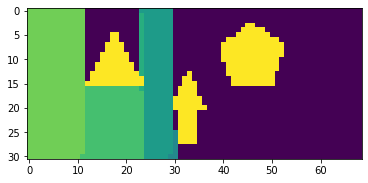

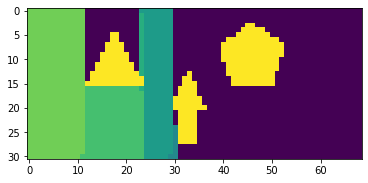

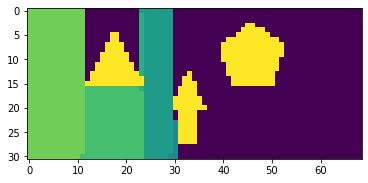

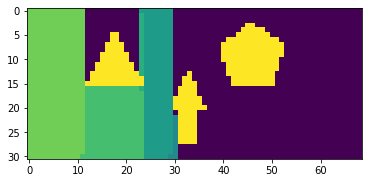

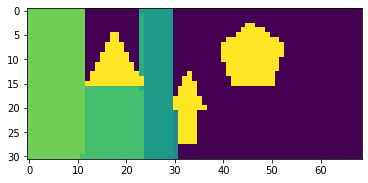

100 True
17 30 21 30


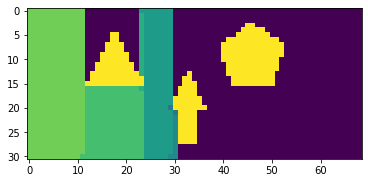

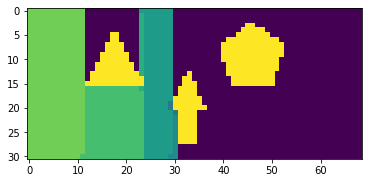

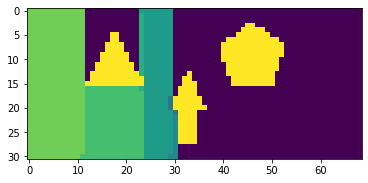

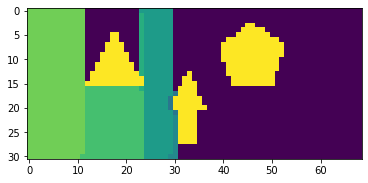

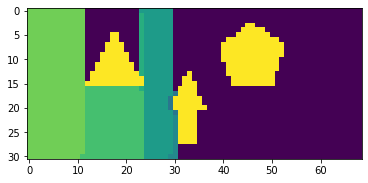

...

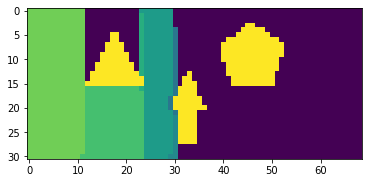

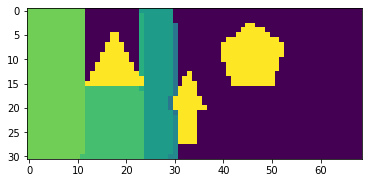

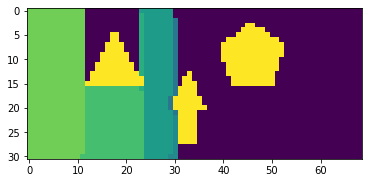

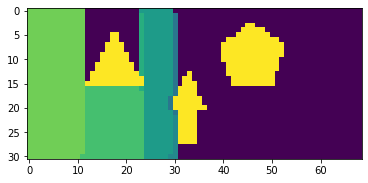

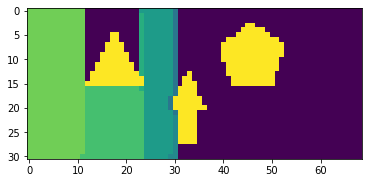

120 False
0 31 0 30


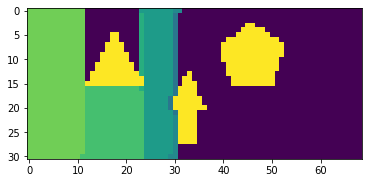

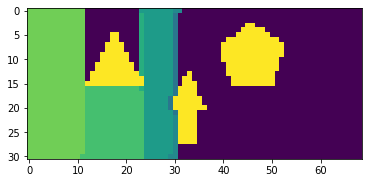

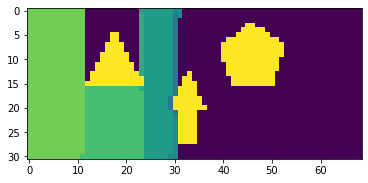

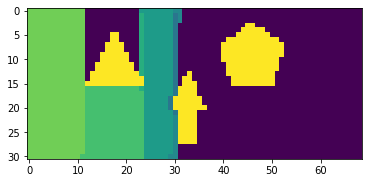

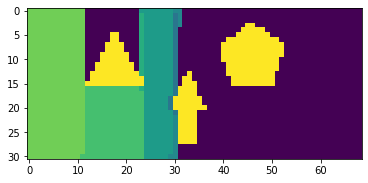

...

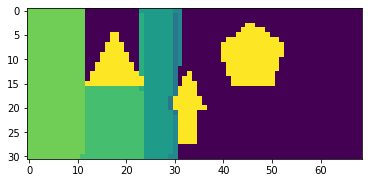

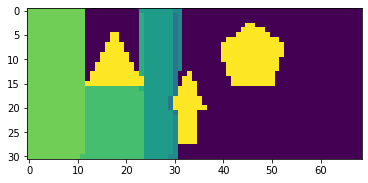

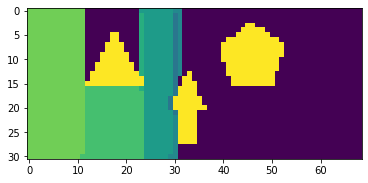

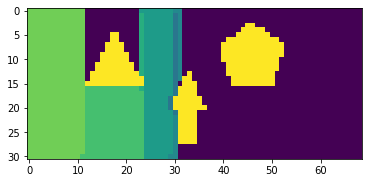

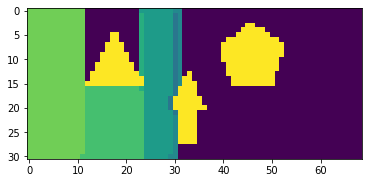

140 False
13 32 15 31


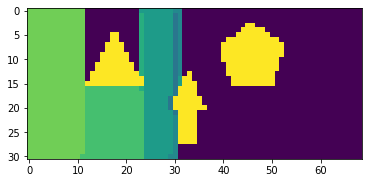

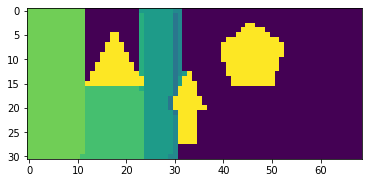

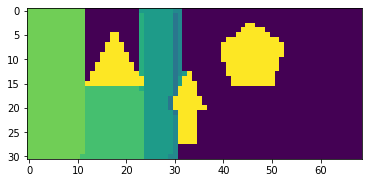

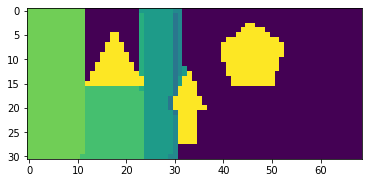

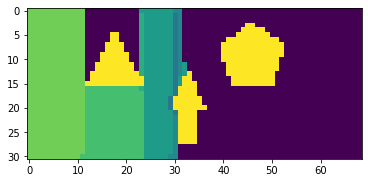

...

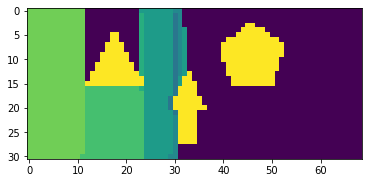

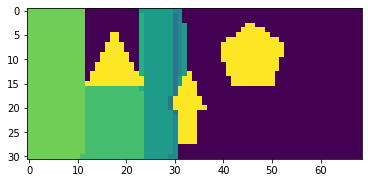

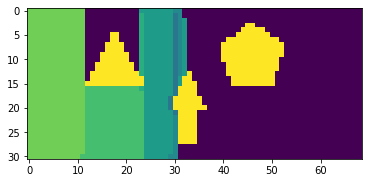

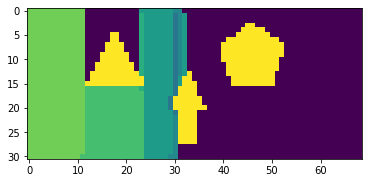

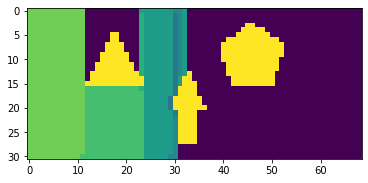

160 False
0 33 0 32


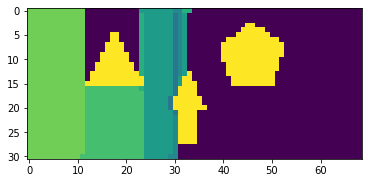

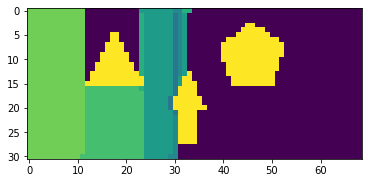

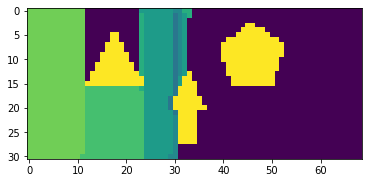

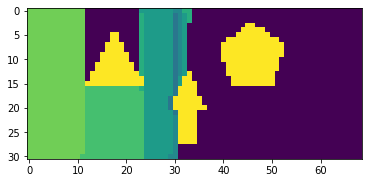

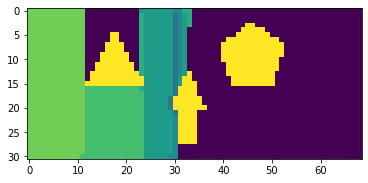

...

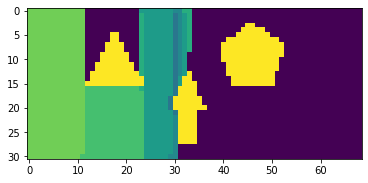

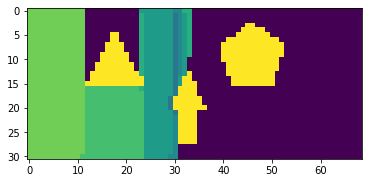

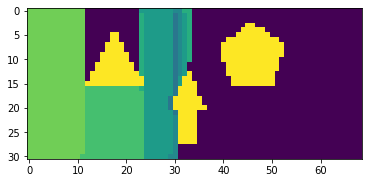

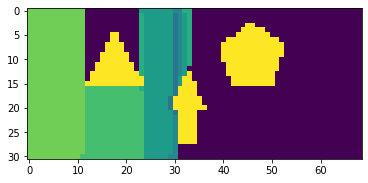

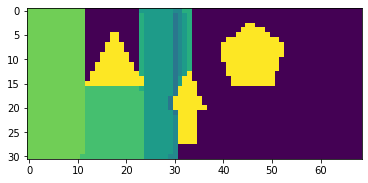

180 False
14 34 12 33


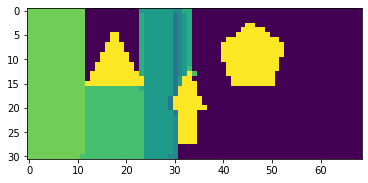

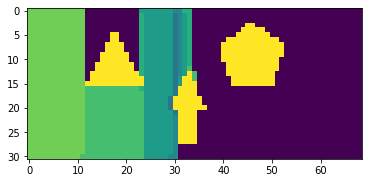

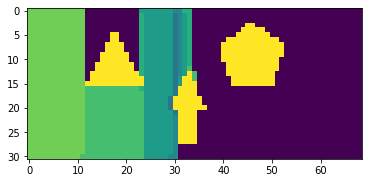

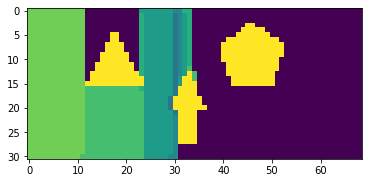

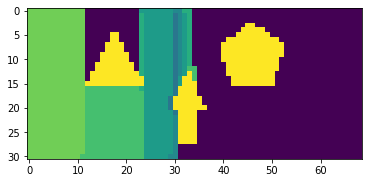

...

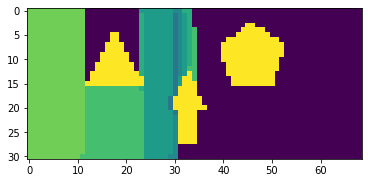

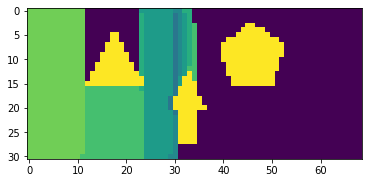

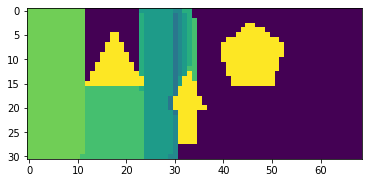

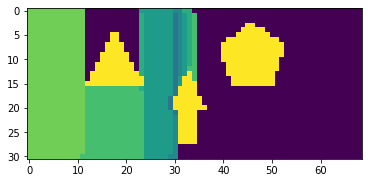

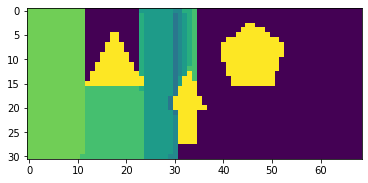

200 False
0 35 0 34


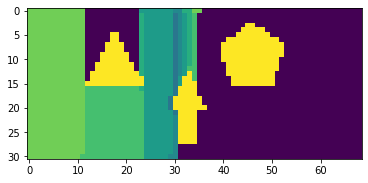

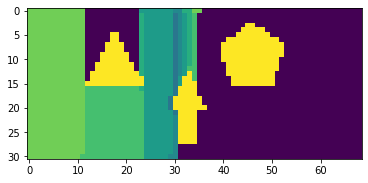

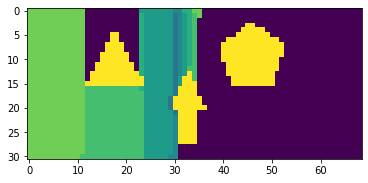

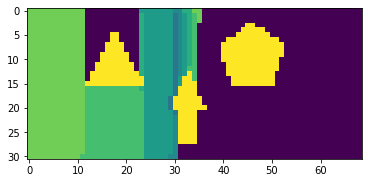

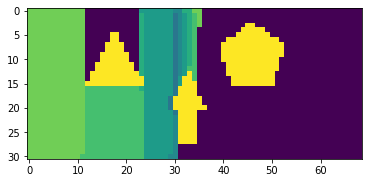

...

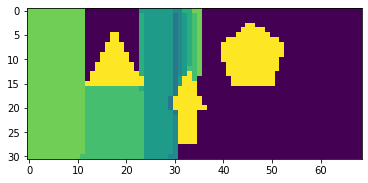

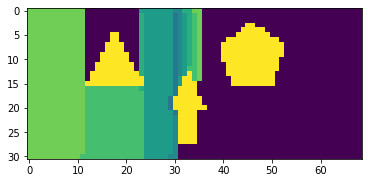

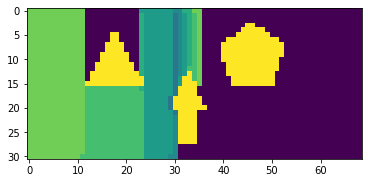

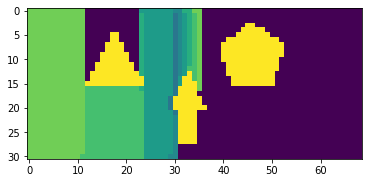

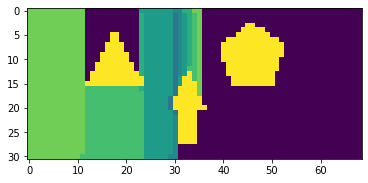

200 True
19 36 17 35


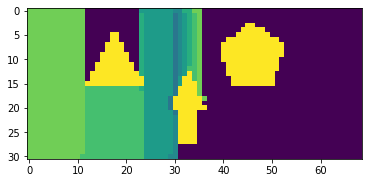

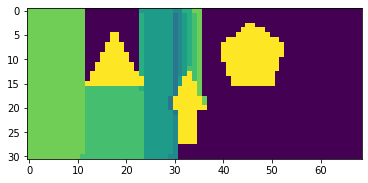

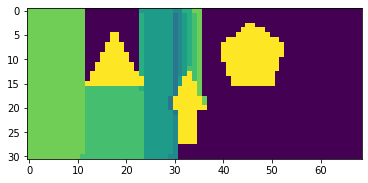

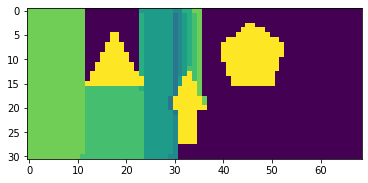

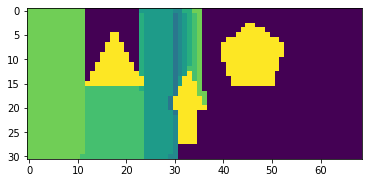

...

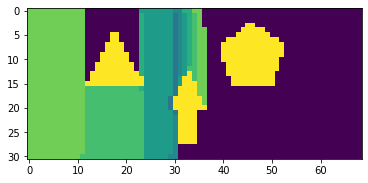

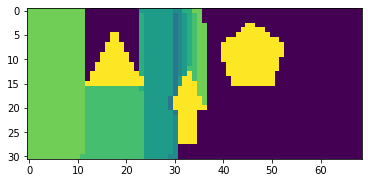

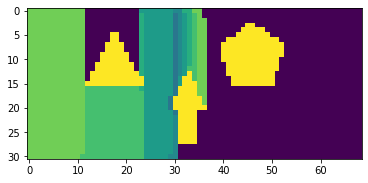

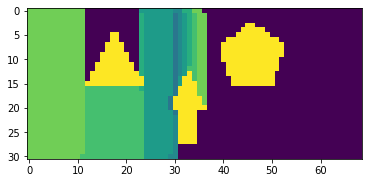

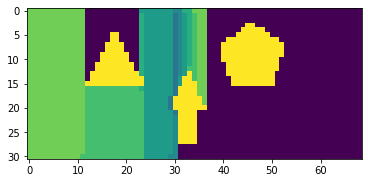

180 True
0 37 0 36


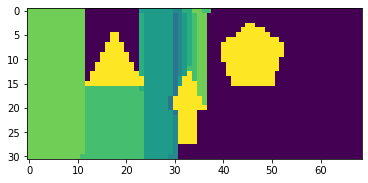

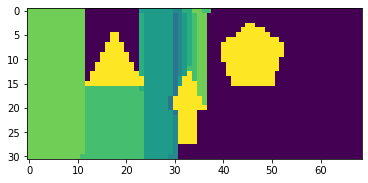

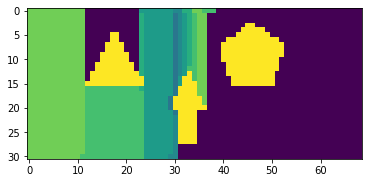

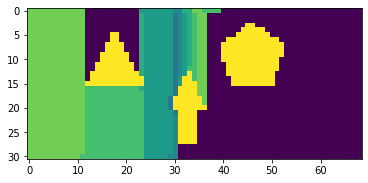

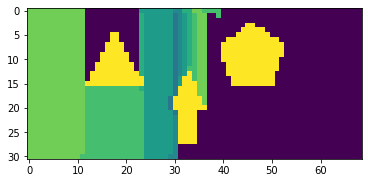

...

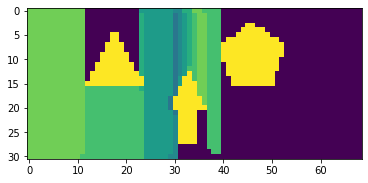

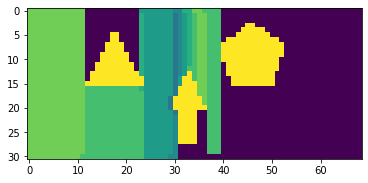

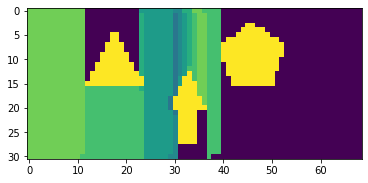

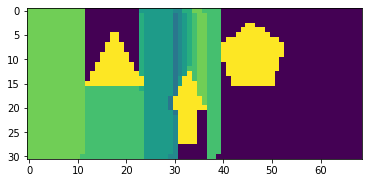

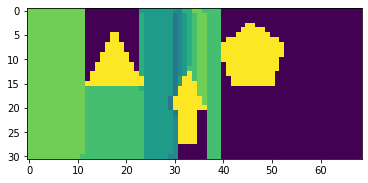

160 True
30 40 30 39


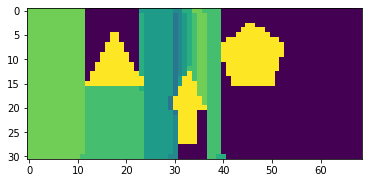

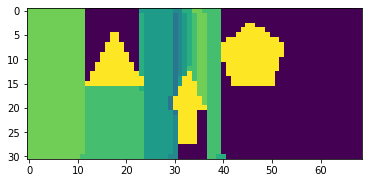

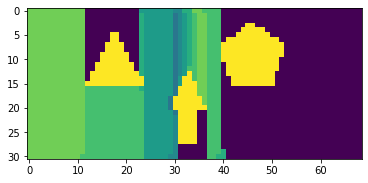

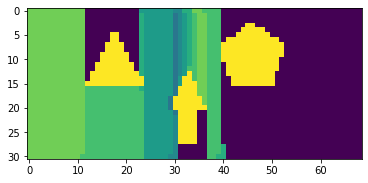

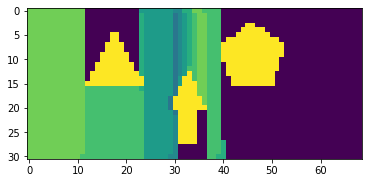

...

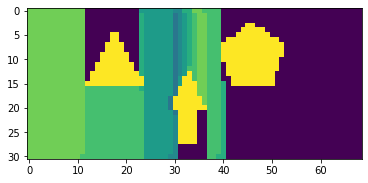

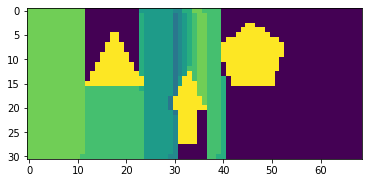

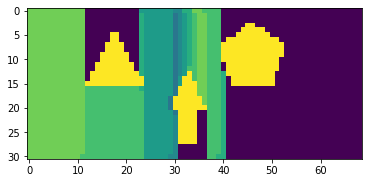

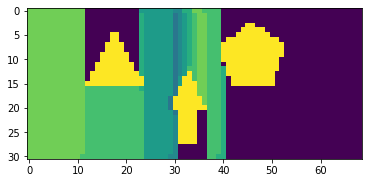

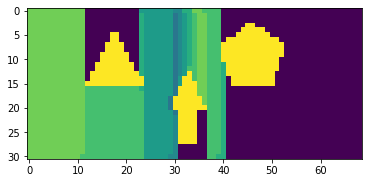

140 True
14 41 11 40


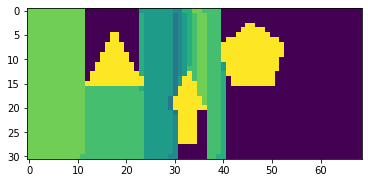

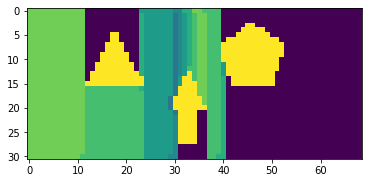

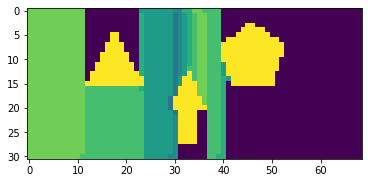

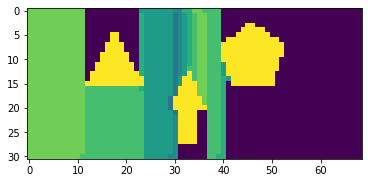

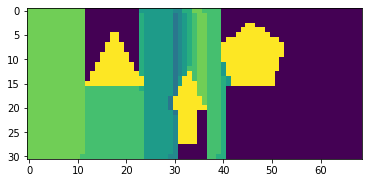

...

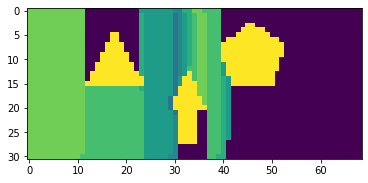

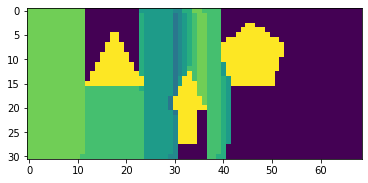

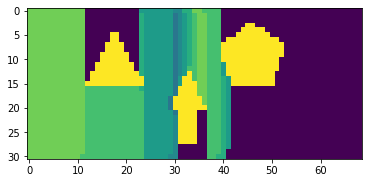

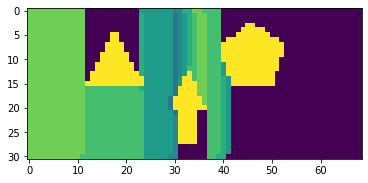

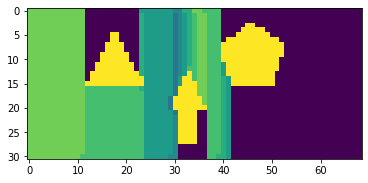

120 True
30 42 30 41


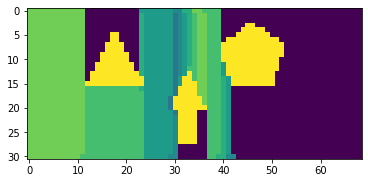

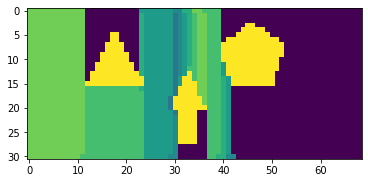

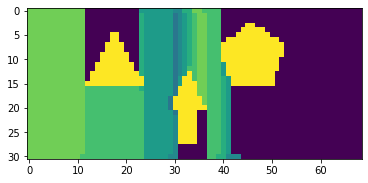

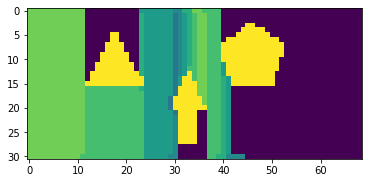

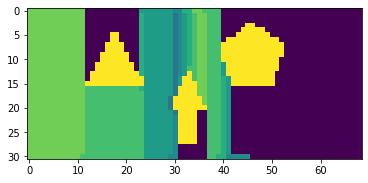

...

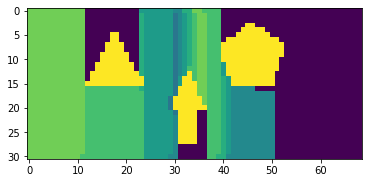

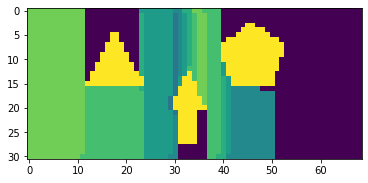

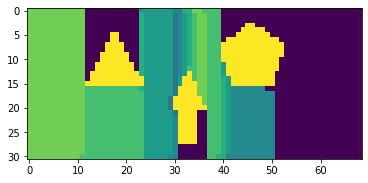

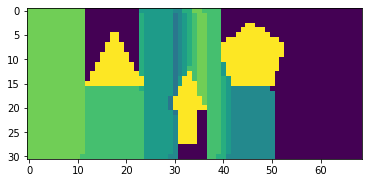

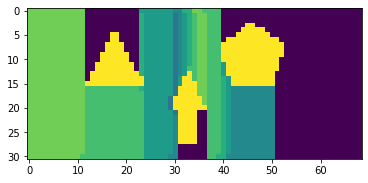

100 True
13 51 16 50


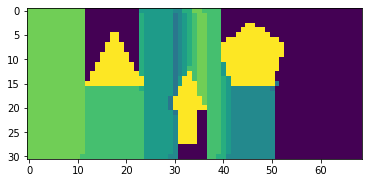

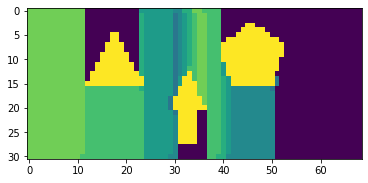

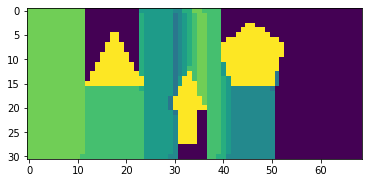

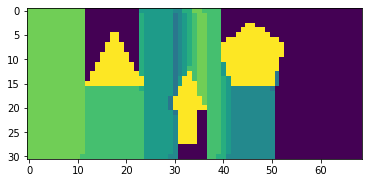

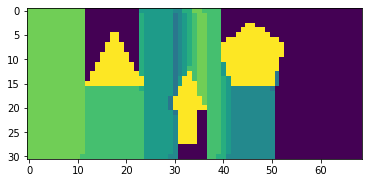

...

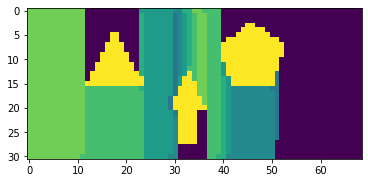

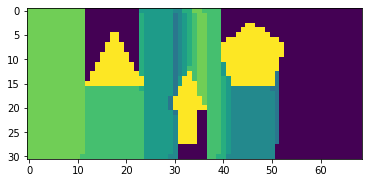

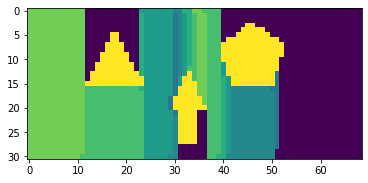

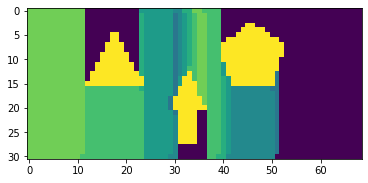

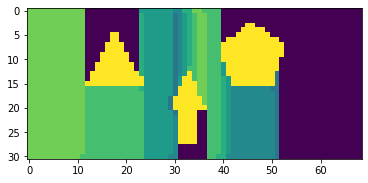

120 False
30 52 30 51


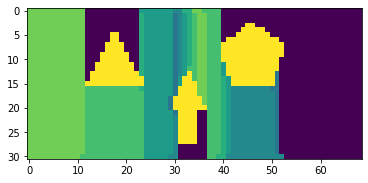

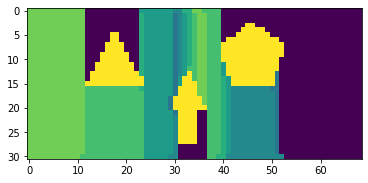

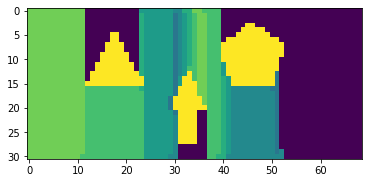

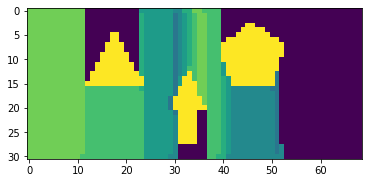

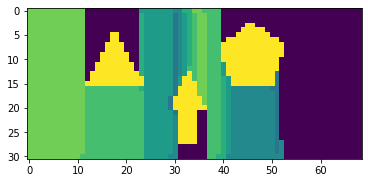

...

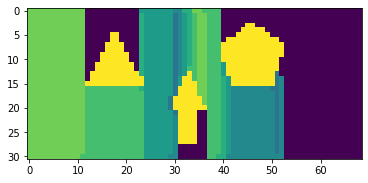

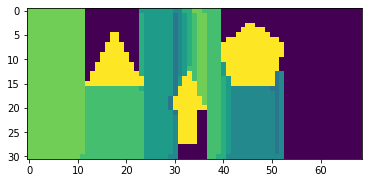

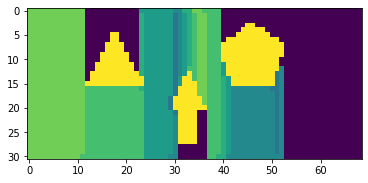

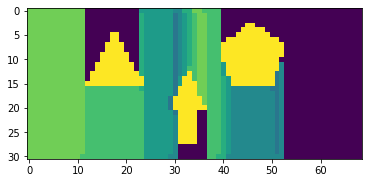

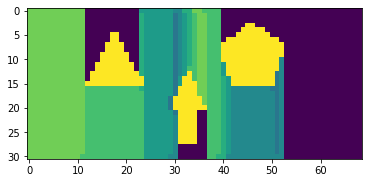

140 False
6 52 10 52


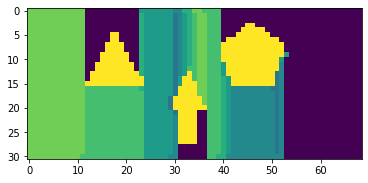

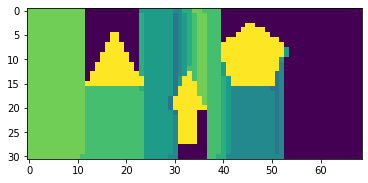

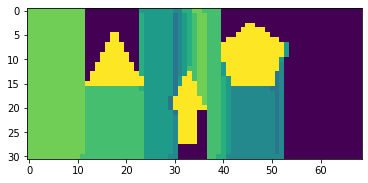

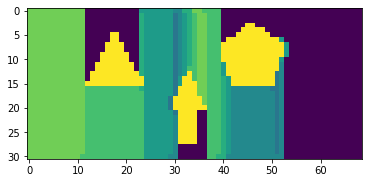

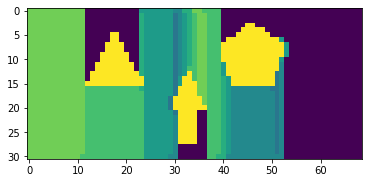

...

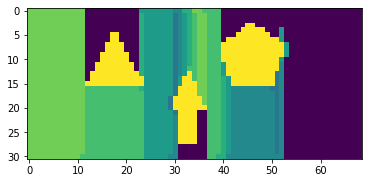

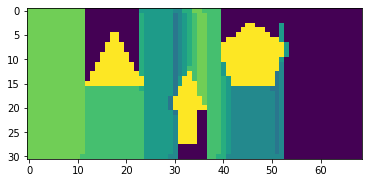

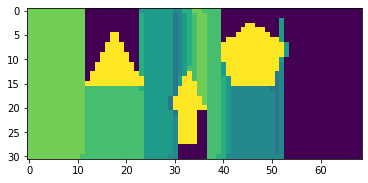

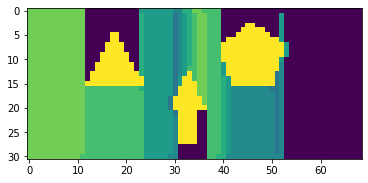

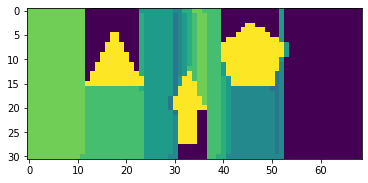

160 False
0 53 0 52


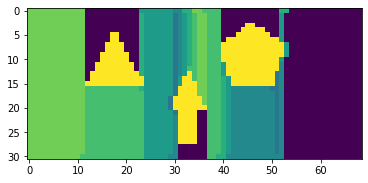

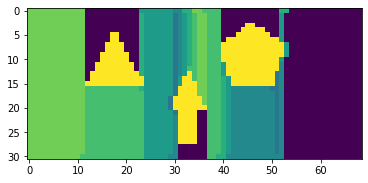

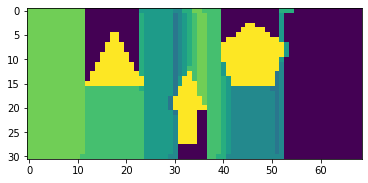

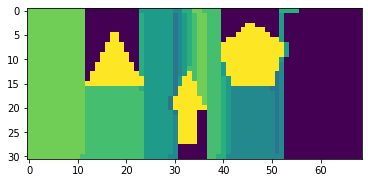

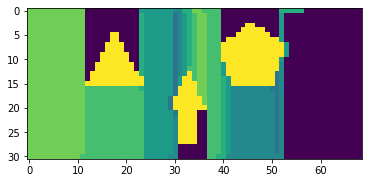

...

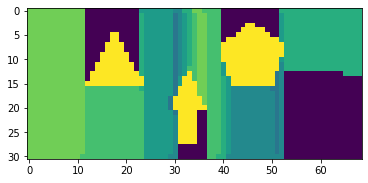

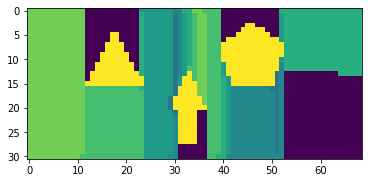

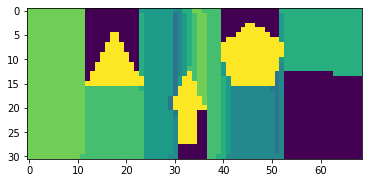

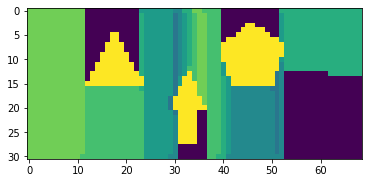

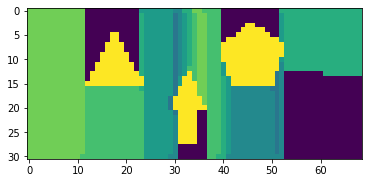

180 False
5 50 30 68


200 False
0 49 0 50


200 True
3 47 4 49


180 True
0 46 0 47


160 True
3 44 2 45


140 True
0 43 0 44


120 True
5 41 4 43


100 True
0 40 0 41


120 False
21 36 6 40


140 False
28 34 30 36


160 False
12 22 30 31


180 False
0 21 0 22


200 False
8 20 10 21


200 True
0 19 0 20


180 True
4 17 6 19


160 True
0 16 0 18


140 True
8 15 6 16


120 True
0 14 0 15


100 True
12 13 10 14


120 False
0 12 0 13


In [36]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    if movement == 'Down':
        sr_x,sr_y = traversal_map_down(c_cell,value,side)
    else:
        sr_x,sr_y = traversal_map_up(c_cell,value,side)
    
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [131]:
######Different Type of Movements

In [147]:
###VerticalTraversal from left to Right

def traversal_map_left_vertical(A,value,movement):
    m = A.shape[0]
    n = A.shape[1]
    
    if movement == 'Down':
        i=0
        j=0
        alt = True
        
        while j !=n :
            if alt == True:
                A[i][j] = value
                i+=1
                if i==m:
                    j+=1
                    alt=False
            else:
                i-=1
                A[i][j] = value
                if i==0:
                    j+=1
                    alt=True
            full_grid()
        
        if alt == True:
            return 0,n-1
        else:
            return m-1,n-1
    else:
        i=m-1
        j =0
        alt = True
        
        while j != n:
            if alt == True:
                A[i][j] = value
                i-=1
                if i == -1 :
                    j+=1
                    alt = False
            
            else:
                i+=1
                A[i][j] = value
                if i == m-1 :
                    j+=1
                    alt = True
            full_grid()
        
        if alt == True:
            return m-1,n-1
        else:
            return 0,n-1

In [148]:
###Vertical Traversal from Right to Left

def traversal_map_right_vertical(A,value,movement):
    m = A.shape[0]
    n = A.shape[1]
    
    if movement == 'Down':
        i=0    
        j=n-1
        alt = False
        
        while j!=-1:
            if alt == False:
                A[i][j] = value
                i+=1
                
                if i==m:
                    j-=1
                    alt = True
            else:
                i-=1
                A[i][j] = value
                if i == 0:
                    j-=1
                    alt = False
            full_grid()
            
        if alt == True:
            return m-1,0
        else:
            return 0,0
    
    else:
        i=m-1    
        j=n-1
        alt = False
        
        while j!=-1:
            if alt == False:
                A[i][j] = value
                i-=1
                
                if i==-1:
                    j-=1
                    alt = True
            else:
                i+=1
                A[i][j] = value
                if i == m-1:
                    j-=1
                    alt = False
            full_grid()
        
        if alt == True:
            return 0,0
        else:
            return m-1,0

In [150]:
###Function for Reordering the cells list


def next_cell(sr_x,sr_y,cell_dict,cell_i):
    nearest = None
    nearest_index = None
    movement = None
    side = None
    
    for ind,c in cell_dict.items():
        mov = None
        s = None
        
        if ind == cell_i:
            continue
        
        de_x_d_l = c[0]
        de_y_d_l = c[2]
        d_d_l = distance_formula(sr_x,sr_y,de_x_d_l,de_y_d_l)
        
        de_x_u_l = c[1]
        de_y_u_l = c[2]
        d_u_l = distance_formula(sr_x,sr_y,de_x_u_l,de_y_u_l)
        
        de_x_d_r = c[0]
        de_y_d_r = c[3]
        d_d_r = distance_formula(sr_x,sr_y,de_x_d_r,de_y_d_r)
        
        de_x_u_r = c[1]
        de_y_u_r = c[3]
        d_u_r = distance_formula(sr_x,sr_y,de_x_u_r,de_y_u_r)
        
        dists = np.array([d_d_l,d_u_l,d_d_r,d_u_r])
        K = np.argmin(dists)
        d = dists[K]
        
        if K==0:
            mov = 'Down'
            s = 'Left'
        if K==1:
            mov = 'Up'
            s = 'Left'
        if K==2:
            mov = 'Down'
            s = 'Right'
        if K==3:
            mov = 'Up'
            s = 'Right'
            
        if nearest == None or nearest > d:
            
            nearest = d
            nearest_index = ind
            movement = mov
            side = s
    del cell_dict[cell_i]
        
    cell_i = nearest_index
    
    cell_chosen = cell_dict[cell_i]
    length = cell_chosen[1] - cell_chosen[0]
    breath = cell_chosen[3] - cell_chosen[2]
    
    return side,movement,cell_i,cell_dict[cell_i]

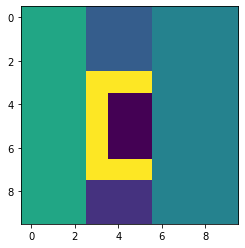

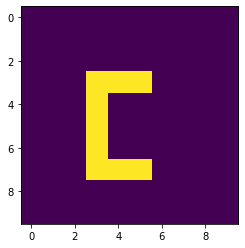

{}


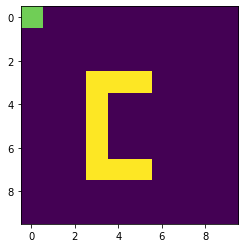

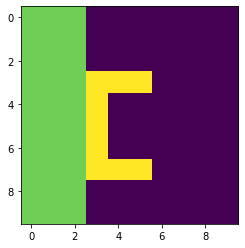

180 True
9 3 9 2


160 True
6 4 8 3


140 True
9 6 6 5


120 True
2 5 9 9


In [151]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    
    length = cell[1] - cell[0]
    breath = cell[3] - cell[2]
    if length > breath:
        direction = 'Vertical'
    else:
        direction = 'Horizontal'
    
    if direction == 'Vertical':
        if side == 'Left':
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
        else:
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
    else:
        if movement == 'Down':
            sr_x,sr_y = traversal_map_down(c_cell,value,side)
        else:
            sr_x,sr_y = traversal_map_up(c_cell,value,side)
            
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [152]:
###Reading an Image
import cv2 as cv

MAP_test = cv.imread('Map_test_1.png')
MAP_test_gs = cv.cvtColor(MAP_test, cv.COLOR_BGR2GRAY)
_,MAP_test_work = cv.threshold(MAP_test_gs,127,255,cv.THRESH_BINARY_INV)
MAP = MAP_test_work
print(MAP.shape)

(17, 29)


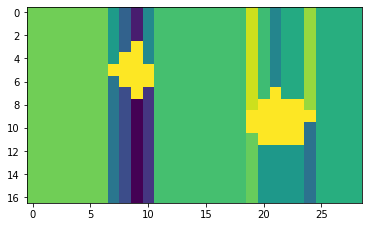

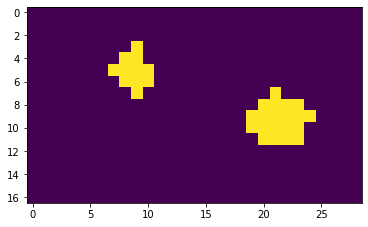

{}


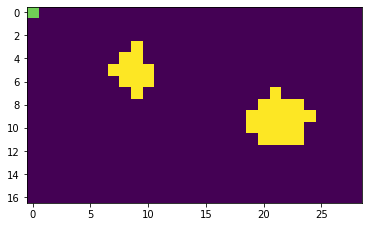

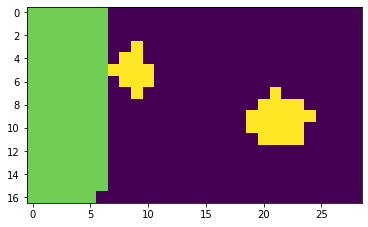

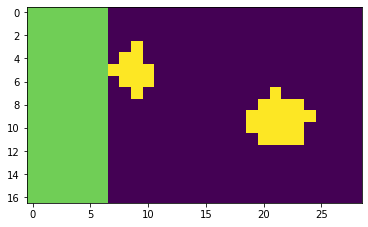

180 True
16 7 16 6


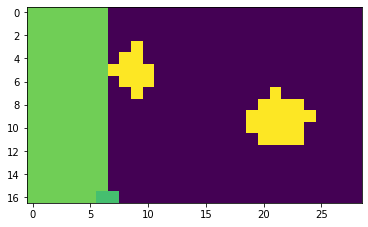

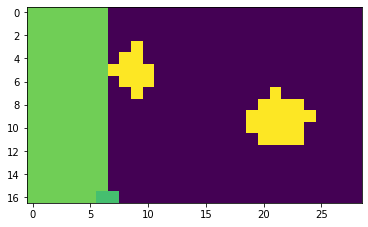

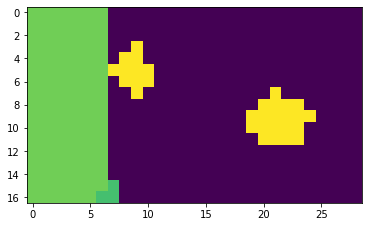

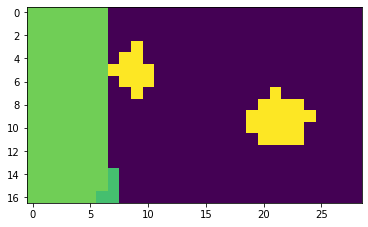

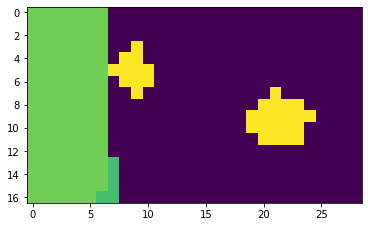

...

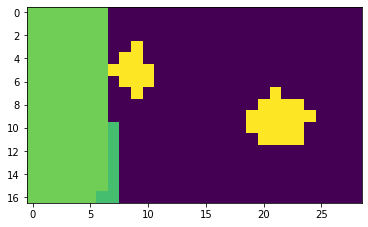

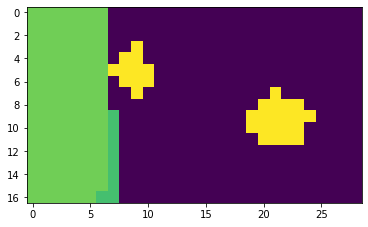

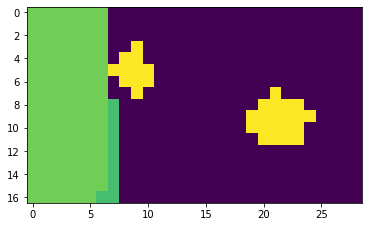

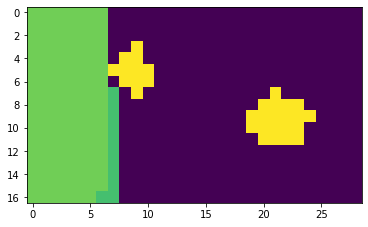

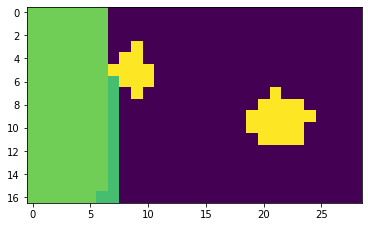

160 True
7 8 6 7


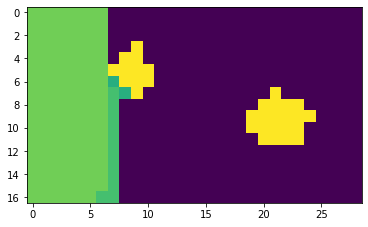

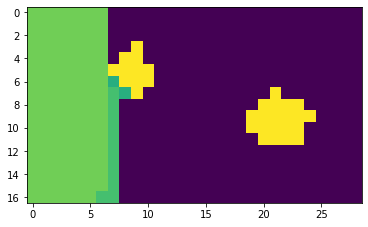

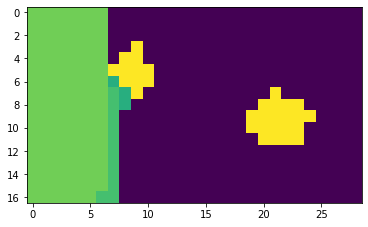

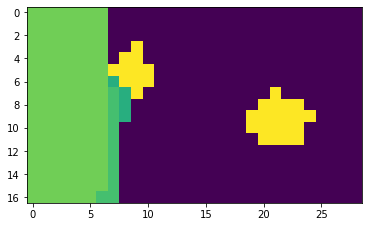

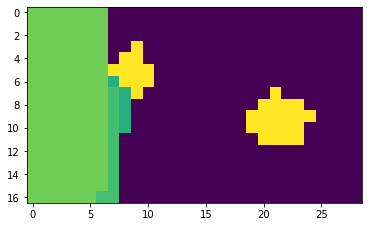

...

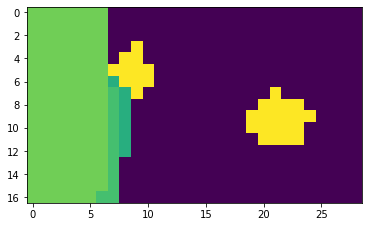

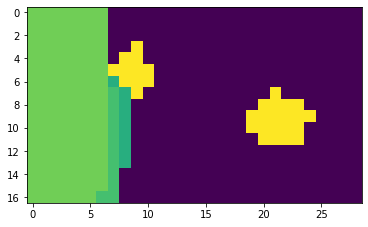

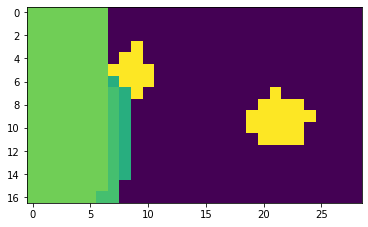

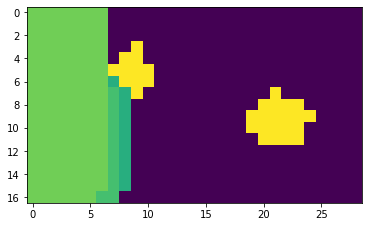

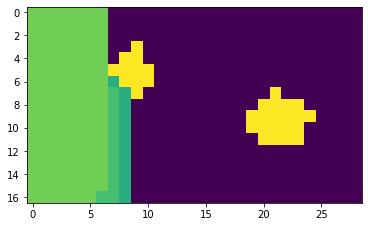

140 True
16 9 16 8


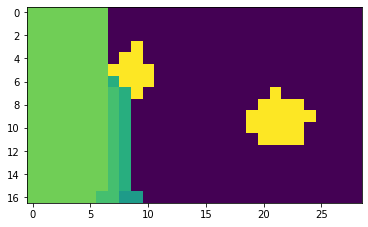

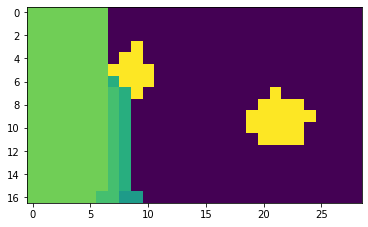

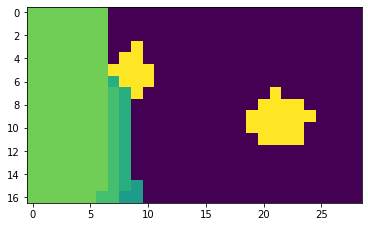

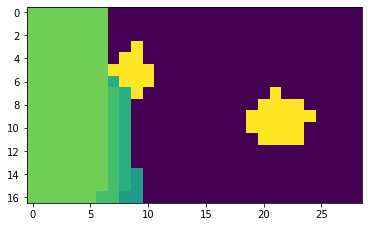

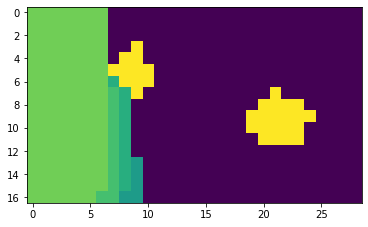

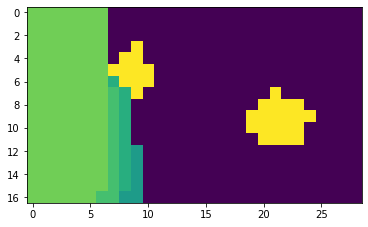

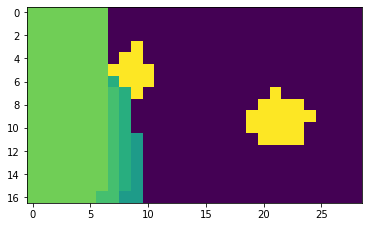

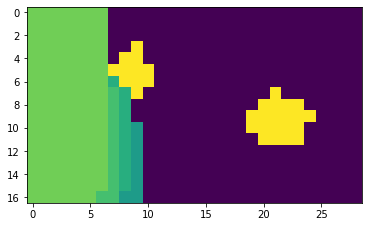

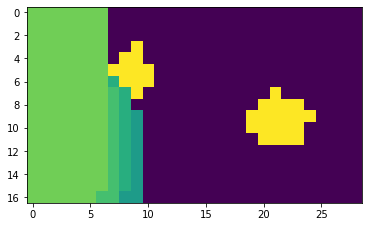

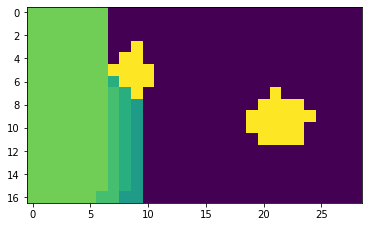

120 True
7 10 8 9


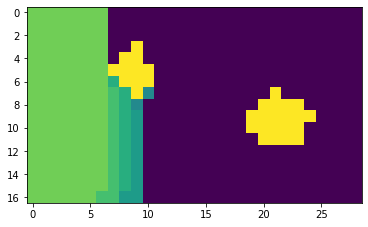

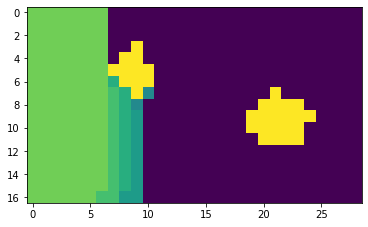

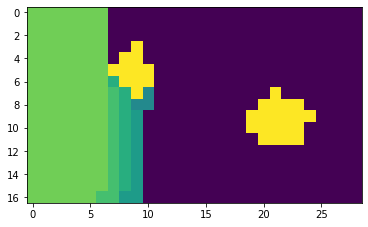

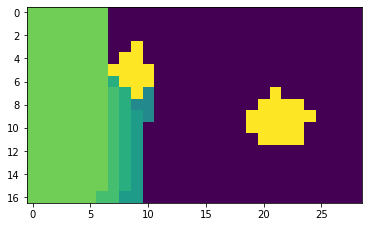

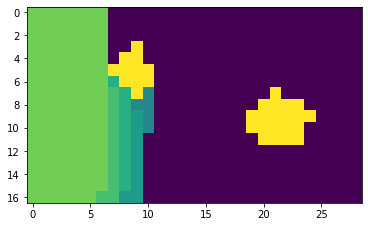

...

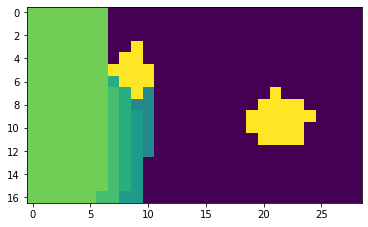

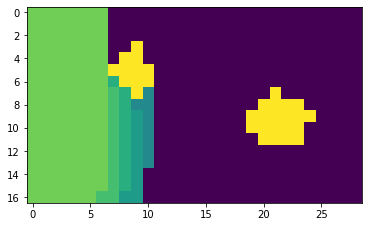

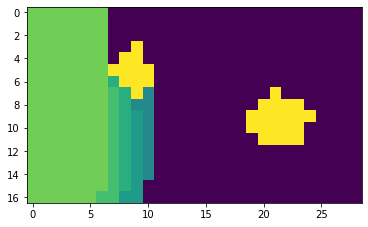

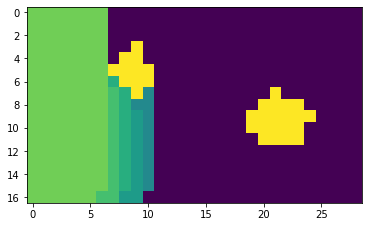

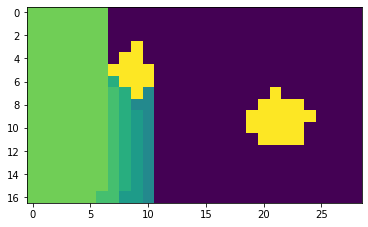

100 True
16 11 16 10


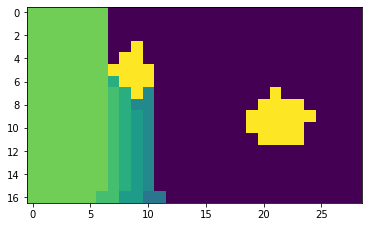

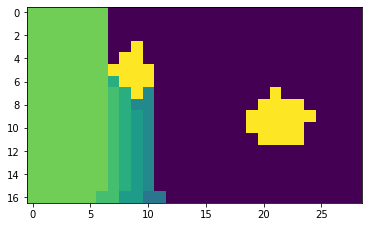

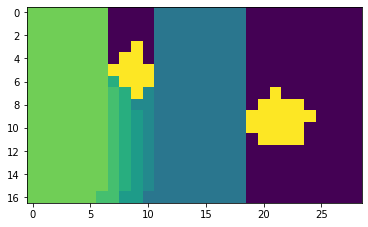

120 False
16 19 16 18


140 False
12 20 11 19


160 False
10 24 12 23


180 False
16 25 16 24


200 False
8 24 16 28


200 True
0 23 0 24


180 True
0 21 0 23


160 True
7 20 6 21


140 True
0 19 0 20


120 True
4 10 8 19


100 True
0 9 0 10


120 False
3 8 2 9


140 False
0 7 0 8


In [153]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    
    length = cell[1] - cell[0]
    breath = cell[3] - cell[2]
    if length > breath:
        direction = 'Vertical'
    else:
        direction = 'Horizontal'
    
    if direction == 'Vertical':
        if side == 'Left':
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
        else:
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
    else:
        if movement == 'Down':
            sr_x,sr_y = traversal_map_down(c_cell,value,side)
        else:
            sr_x,sr_y = traversal_map_up(c_cell,value,side)
            
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

In [154]:
###Reading an Image
import cv2 as cv

MAP_test = cv.imread('Map_test_3.png')
MAP_test_gs = cv.cvtColor(MAP_test, cv.COLOR_BGR2GRAY)
_,MAP_test_work = cv.threshold(MAP_test_gs,127,255,cv.THRESH_BINARY_INV)
MAP = MAP_test_work
print(MAP.shape)

(42, 52)


In [155]:
###Execution

value = 200
down = True

grids = grid_division(MAP)

cell_display(MAP,grids)

plt.imshow(MAP)
plt.show()

cell_index = 0
cell_dict = dict()
print(cell_dict)

for cell in grids:
    cell_dict[cell_index]  = cell
    cell_index+=1

cell_index = 0
movement = 'Down'
side = 'Left'

while len(cell_dict)!=0:
    cell = cell_dict[cell_index]
    start_i = cell[0]
    end_i = cell[1]+1
    start_j = cell[2]
    end_j = cell[3]+1
    c_cell = MAP[start_i:end_i,start_j:end_j]
    
    length = cell[1] - cell[0]
    breath = cell[3] - cell[2]
    if length > breath:
        direction = 'Vertical'
    else:
        direction = 'Horizontal'
    
    if direction == 'Vertical':
        if side == 'Left':
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
        else:
            sr_x,sr_y = traversal_map_left_vertical(c_cell,value,movement)
    else:
        if movement == 'Down':
            sr_x,sr_y = traversal_map_down(c_cell,value,side)
        else:
            sr_x,sr_y = traversal_map_up(c_cell,value,side)
            
    sr_x += start_i
    sr_y += start_j 
    
    if len(cell_dict) == 1:
        break
    
    if len(cell_dict) > 1:
        side,movement,next_index,n_cell = next_cell(sr_x,sr_y,cell_dict,cell_index)
        
    if movement == 'Down':
        if side == 'Left':
            de_x = n_cell[0]
            de_y = n_cell[2]
        else:
            de_x = n_cell[0]
            de_y = n_cell[3]
    else:
        if side == 'Left':
            de_x = n_cell[1]
            de_y = n_cell[2]
        else:
            de_x = n_cell[1]
            de_y = n_cell[3]
    
    if value == 100 and down == True:
        down = False
    
    if down == True:
        value -= 20
    
    if value == 200 and down == False:
        down = True
    
    if down == False:
        value += 20
    
    print(value,down)
    
    print(de_x,de_y,sr_x,sr_y)
    dijkstra(de_x,de_y,sr_x,sr_y,MAP,value)
    
    cell_index = next_index

{}


180 True
41 17 41 16


160 True
18 17 34 17


140 True
13 23 18 22


120 True
18 29 13 28


100 True
13 35 18 34


120 False
18 43 13 42


140 False
0 44 0 43
